In [1]:
print("Importing libraries")
import torch
from torch.nn import CrossEntropyLoss
from torch.utils.data import DataLoader
import numpy as np
import os
import nrrd
import pytorch_lightning as pl #python -m pip install lightning
print("Importing MONAI")
from monai.data import CacheDataset, DataLoader
from monai.transforms import Compose, Lambda, RandSpatialCrop, RandRotate90, ToTensor, ScaleIntensityRange
from monai.networks.nets import AutoEncoder
from monai.losses import SSIMLoss
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
from pytorch_lightning.callbacks import ModelCheckpoint
import torch.nn as nn
import torch.optim.lr_scheduler as lr_scheduler
import time
print("Done importing libraries")

Importing libraries


Importing MONAI


Done importing libraries


In [2]:
#Using AutoEncoder instead of UNet to avoid skip connections 
class SlicePlotter:
    def __init__(self):
        pass

    def plot_slices(self, original_slice, reconstruction_slice, title):
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(original_slice, cmap='gray')
        plt.title(f'Original {title} Slice\nMin: {original_slice.min().round(2)}, Max: {original_slice.max().round(2)}')
        plt.colorbar()
        plt.subplot(1, 2, 2)
        plt.imshow(reconstruction_slice, cmap='gray')  # Specify vmin and vmax here , vmin=-0.5, vmax=0.5
        plt.title(f'Reconstructed {title} Slice\nMin: {reconstruction_slice.min().round(2)}, Max: {reconstruction_slice.max().round(2)}')
        plt.colorbar()
        plt.show()
    
    def plot_histograms(self, original_slice, reconstruction_slice, title):
        fig, axes = plt.subplots(1, 2, figsize=(15, 5))

        # Plot histogram for original slice
        axes[0].hist(original_slice.flatten(), bins=50, color='b', alpha=0.7)
        axes[0].set_title(f'Original {title} Slice Histogram')
        axes[0].set_xlabel('Pixel Value')
        axes[0].set_ylabel('Frequency')

        # Plot histogram for reconstruction slice
        axes[1].hist(reconstruction_slice.flatten(), bins=50, color='r', alpha=0.7)
        axes[1].set_title(f'Reconstructed {title} Slice Histogram')
        axes[1].set_xlabel('Pixel Value')
        axes[1].set_ylabel('Frequency')

        plt.tight_layout()
        plt.show()

class AutoEncoderModel(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.autoencoder = AutoEncoder(
            spatial_dims=3, 
            in_channels=1,  
            out_channels=1,  
            channels=(16, 32, 64, 128, 64), 
            strides=(2, 2, 2, 2, 2), 
            kernel_size=3, 
            num_res_units=2
            
        )
        self.loss_function =  nn.MSELoss()
        self.slice_plotter = SlicePlotter()

    def forward(self, x):
        return self.autoencoder(x)
   
    def training_step(self, batch, batch_idx):
        x, y = batch
        # x = x.unsqueeze(1)  # Add channel dimension
        # y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('train_loss', loss)

        if self.current_epoch % ShowInterval == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Train Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Train Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Train Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        # x = x.unsqueeze(1)  # Add channel dimension
        # y = y.unsqueeze(1)  # Add channel dimension
        x_hat = self(x)
        
        # Ensure y_pred has the correct shape (batch_size, 1, height, width, depth)
        y_pred = x_hat 
        
        loss = self.loss_function(y_pred, y)
        self.log('val_loss', loss)

        if self.current_epoch % ShowInterval == 0 and batch_idx == 0:
            # Random depth slice
            depth_idx = torch.randint(0, x.shape[2], (1,)).item()
            original_depth_slice = x[0, 0, depth_idx, :, :].detach().cpu().numpy()
            reconstruction_depth_slice = x_hat[0, 0, depth_idx, :, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_depth_slice, reconstruction_depth_slice, 'Val Depth')
            self.slice_plotter.plot_histograms(original_depth_slice, reconstruction_depth_slice, 'Depth')

            # Random height slice
            height_idx = torch.randint(0, x.shape[3], (1,)).item()
            original_height_slice = x[0, 0, :, height_idx, :].detach().cpu().numpy()
            reconstruction_height_slice = x_hat[0, 0, :, height_idx, :].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_height_slice, reconstruction_height_slice, 'Val Height')
            self.slice_plotter.plot_histograms(original_height_slice, reconstruction_height_slice, 'Height')

            # Random width slice
            width_idx = torch.randint(0, x.shape[4], (1,)).item()
            original_width_slice = x[0, 0, :, :, width_idx].detach().cpu().numpy()
            reconstruction_width_slice = x_hat[0, 0, :, :, width_idx].detach().cpu().numpy()

            self.slice_plotter.plot_slices(original_width_slice, reconstruction_width_slice, 'Val Width')
            self.slice_plotter.plot_histograms(original_width_slice, reconstruction_width_slice, 'Width')

        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=1e-4)
        return optimizer

class MyDataset(CacheDataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform
        self.files = [f for f in os.listdir(data_dir) if f.endswith('.nrrd')]

    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        file_path = os.path.join(self.data_dir, self.files[idx])
        data, header = nrrd.read(file_path)
        if self.transform:
            data = self.transform(data)
        return data, data

class PlotLossCallback(pl.Callback):
    def __init__(self, log_dir):
        super().__init__()
        self.writer = SummaryWriter(log_dir)

    def on_train_epoch_end(self, trainer, pl_module, **kwargs):
        epoch = trainer.current_epoch
        train_loss = trainer.callback_metrics['train_loss'].cpu().item()
        val_loss = trainer.callback_metrics['val_loss'].cpu().item()

        self.writer.add_scalars(ExperimentDescription, {'training': train_loss, 'validation': val_loss}, global_step=epoch + 1)
        time_spent = time.time() - start_time
        
        print(f"Time Spent {time_spent:.2f}")
        print(f"Epoch: {epoch + 1}")
    def on_train_end(self, trainer, pl_module):
        self.writer.close()

folder_path = "./Models"
if not os.path.exists(folder_path):
        os.makedirs(folder_path)

checkpoint_callback = pl.callbacks.ModelCheckpoint(
    dirpath= folder_path,
    filename='I-AE{epoch}.pth',
    save_last=True,
    verbose=True,
    every_n_epochs=200
)

transform = Compose([
    Lambda(func=lambda x: np.expand_dims(x, 0) if x.ndim == 3 else x),
    RandSpatialCrop((256, 256, 256), random_size=False),
    RandRotate90(prob=0.5),
    ScaleIntensityRange(a_min=-1310, a_max=3310, b_min=-1, b_max=1, clip=True),  # Normalize between -1 and 1
    ToTensor(dtype=torch.float32)
])

In [3]:
start_time = time.time()
device = torch.device("cuda" if torch.cuda.is_available() else "gpu")

train_data_dir = "../../train70"
val_data_dir   = "../../val30"

train_dataset_uc = MyDataset(train_data_dir, transform)
val_dataset_uc   = MyDataset(val_data_dir  , transform)

train_dataset = CacheDataset(train_dataset_uc) # , num_workers=1
val_dataset   = CacheDataset(val_dataset_uc  ) # , num_workers=1

train_dataloader = DataLoader(train_dataset, batch_size=1, shuffle=True ) # ,  num_workers=1
val_dataloader   = DataLoader(val_dataset,   batch_size=1, shuffle=False) # ,  num_workers=1

Loading dataset:   0%|          | 0/18 [00:00<?, ?it/s]

Loading dataset:   6%|▌         | 1/18 [00:03<01:03,  3.75s/it]

Loading dataset:  11%|█         | 2/18 [00:09<01:23,  5.19s/it]

Loading dataset:  17%|█▋        | 3/18 [00:13<01:07,  4.53s/it]

Loading dataset:  22%|██▏       | 4/18 [00:17<00:59,  4.25s/it]

Loading dataset:  28%|██▊       | 5/18 [00:22<00:57,  4.44s/it]

Loading dataset:  33%|███▎      | 6/18 [00:27<00:54,  4.58s/it]

Loading dataset:  39%|███▉      | 7/18 [00:30<00:47,  4.29s/it]

Loading dataset:  44%|████▍     | 8/18 [00:35<00:45,  4.52s/it]

Loading dataset:  50%|█████     | 9/18 [00:41<00:42,  4.74s/it]

Loading dataset:  56%|█████▌    | 10/18 [00:45<00:35,  4.50s/it]

Loading dataset:  61%|██████    | 11/18 [00:48<00:29,  4.17s/it]

Loading dataset:  67%|██████▋   | 12/18 [00:55<00:31,  5.19s/it]

Loading dataset:  72%|███████▏  | 13/18 [00:59<00:23,  4.76s/it]

Loading dataset:  78%|███████▊  | 14/18 [01:04<00:18,  4.62s/it]

Loading dataset:  83%|████████▎ | 15/18 [01:09<00:14,  4.96s/it]

Loading dataset:  89%|████████▉ | 16/18 [01:13<00:09,  4.73s/it]

Loading dataset:  94%|█████████▍| 17/18 [01:18<00:04,  4.52s/it]

Loading dataset: 100%|██████████| 18/18 [01:21<00:00,  4.19s/it]

Loading dataset: 100%|██████████| 18/18 [01:21<00:00,  4.52s/it]

Loading dataset:   0%|          | 0/8 [00:00<?, ?it/s]

Loading dataset:  12%|█▎        | 1/8 [00:03<00:25,  3.66s/it]

Loading dataset:  25%|██▌       | 2/8 [00:11<00:36,  6.01s/it]

Loading dataset:  38%|███▊      | 3/8 [00:14<00:24,  4.95s/it]

Loading dataset:  50%|█████     | 4/8 [00:21<00:21,  5.41s/it]

Loading dataset:  62%|██████▎   | 5/8 [00:24<00:14,  4.76s/it]

Loading dataset:  75%|███████▌  | 6/8 [00:29<00:09,  4.75s/it]

Loading dataset:  88%|████████▊ | 7/8 [00:34<00:04,  4.72s/it]

Loading dataset: 100%|██████████| 8/8 [00:39<00:00,  4.83s/it]

Loading dataset: 100%|██████████| 8/8 [00:39<00:00,  4.89s/it]

In [4]:
trainer = pl.Trainer(
    max_epochs=1501,
    callbacks=[PlotLossCallback("../../logs/"), checkpoint_callback],
    profiler='simple'
)

GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


Missing logger folder: /old_Users/tgafrick/RA4/jobs/job11/lightning_logs


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]



  | Name          | Type        | Params
----------------------------------------------
0 | autoencoder   | AutoEncoder | 2.8 M 
1 | loss_function | MSELoss     | 0     
----------------------------------------------
2.8 M     Trainable params
0         Non-trainable params
2.8 M     Total params
11.291    Total estimated model params size (MB)


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=63` in the `DataLoader` to improve performance.


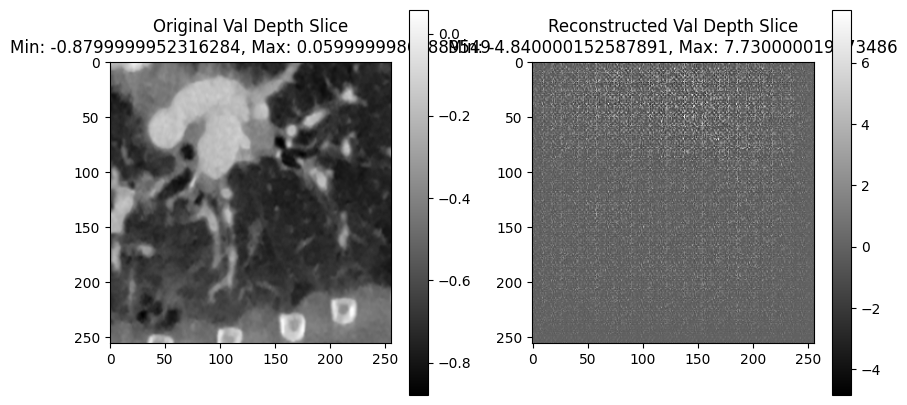

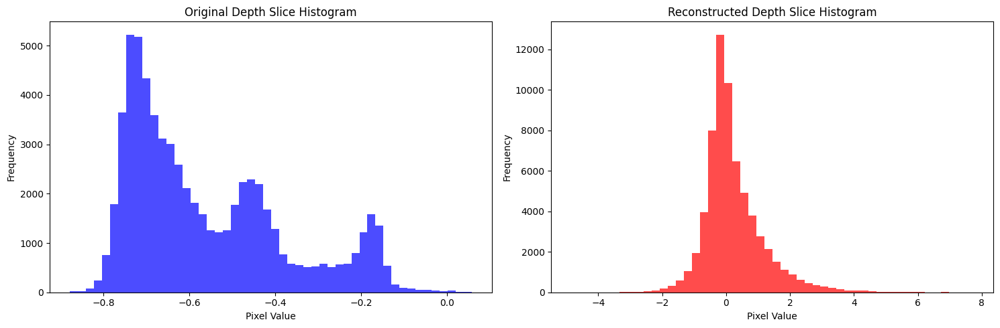

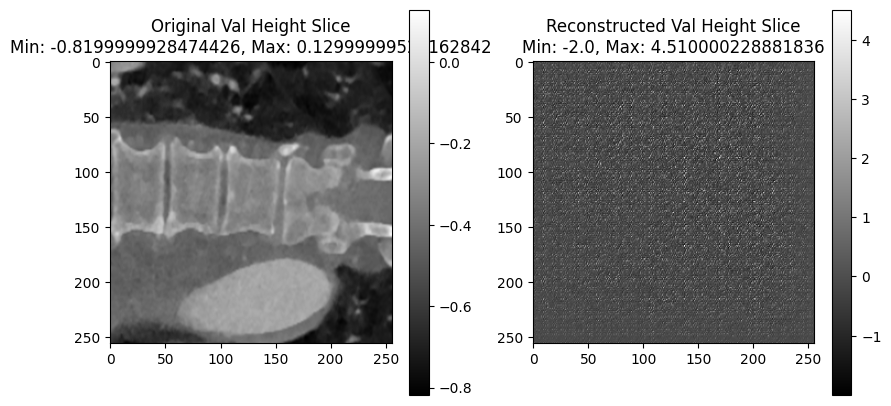

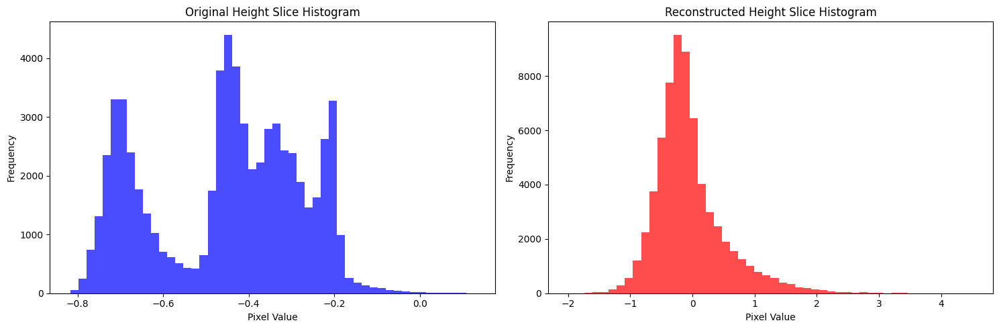

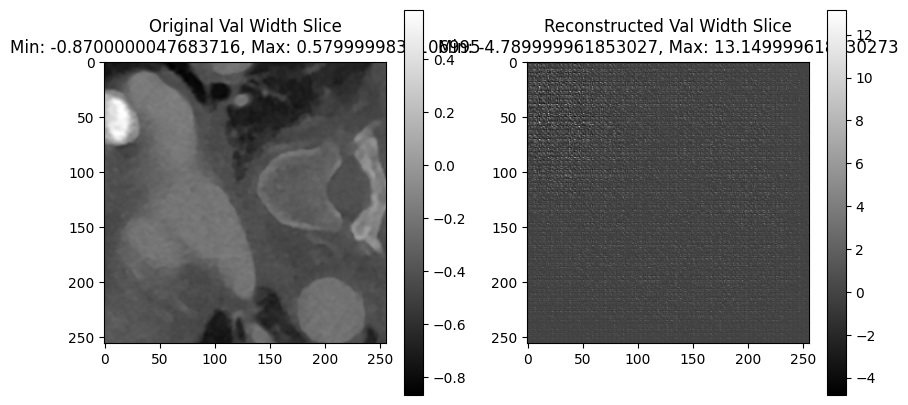

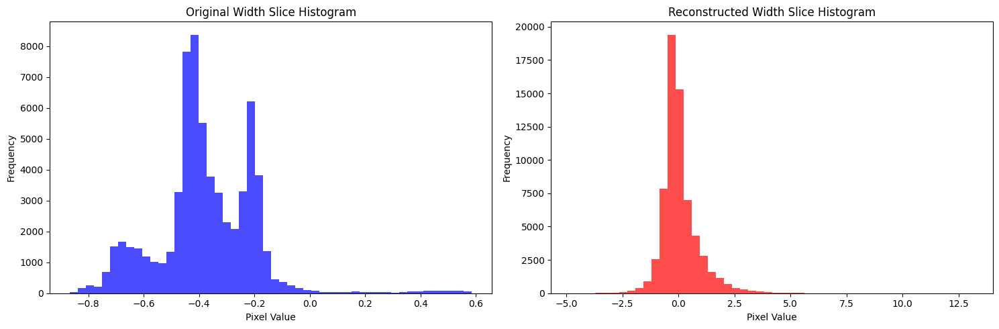

/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=63` in the `DataLoader` to improve performance.
/old_Users/tgafrick/RA4/.venvE/lib/python3.10/site-packages/pytorch_lightning/loops/fit_loop.py:298: The number of training batches (18) is smaller than the logging interval Trainer(log_every_n_steps=50). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

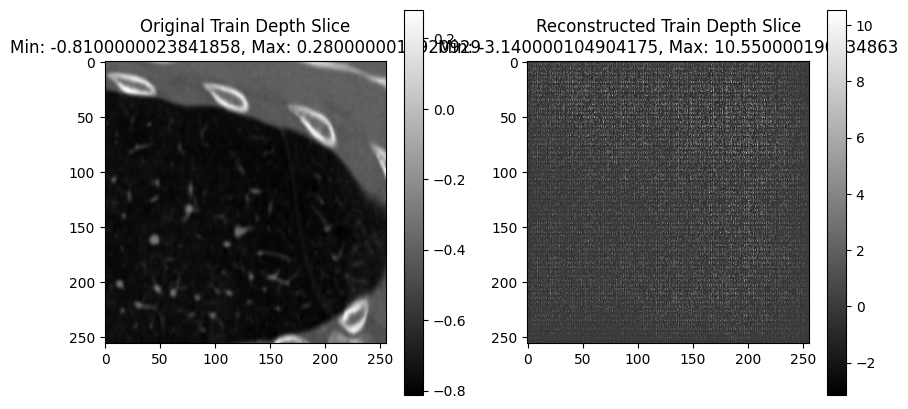

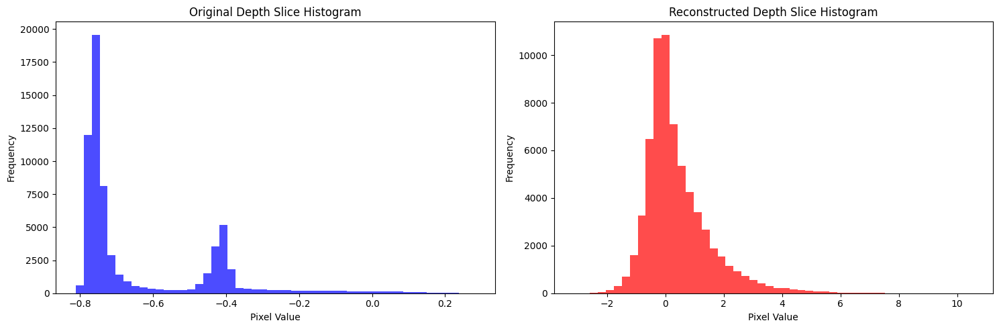

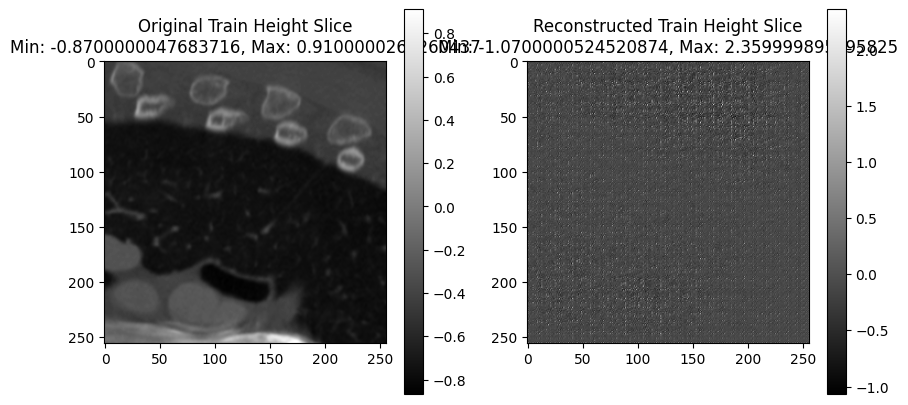

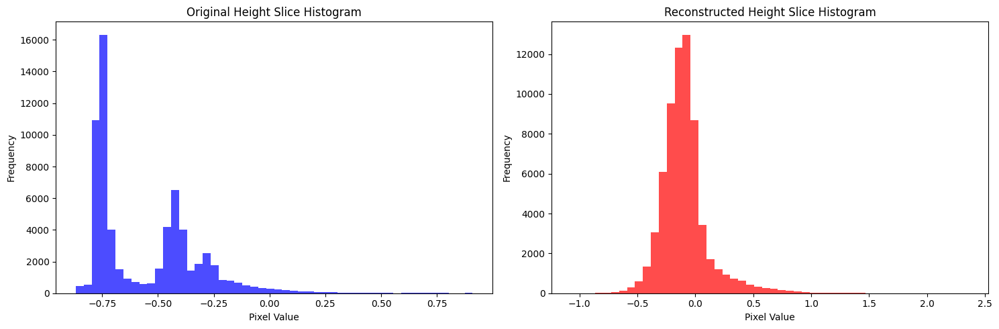

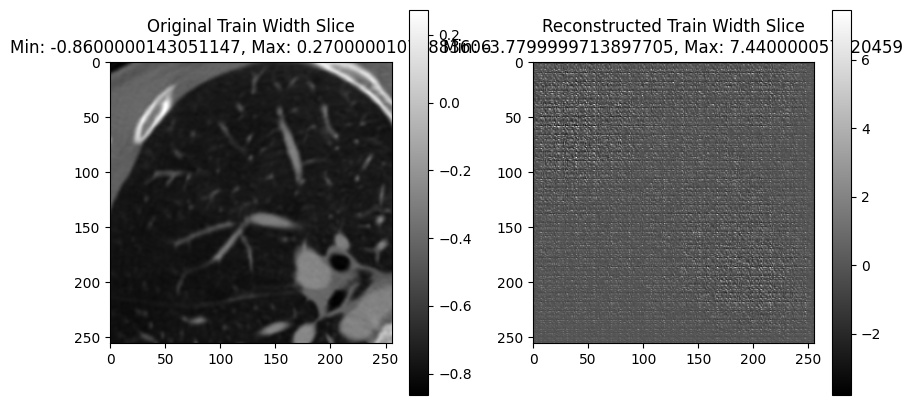

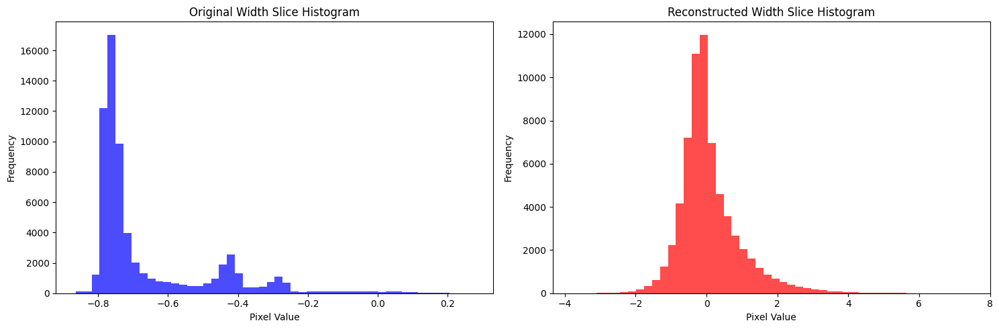

Validation: |          | 0/? [00:00<?, ?it/s]

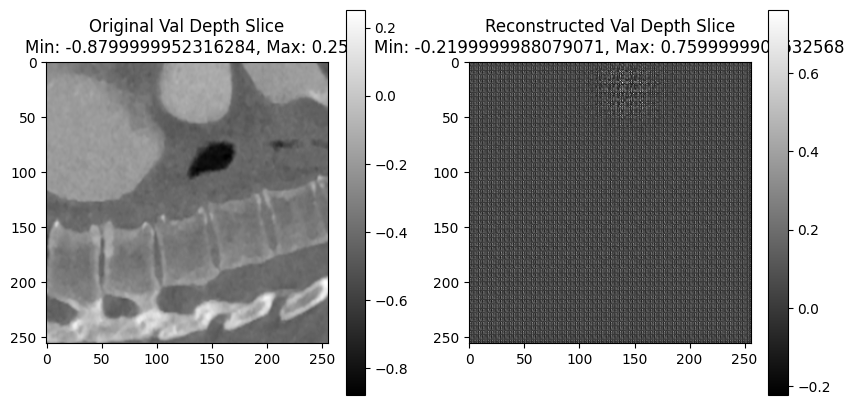

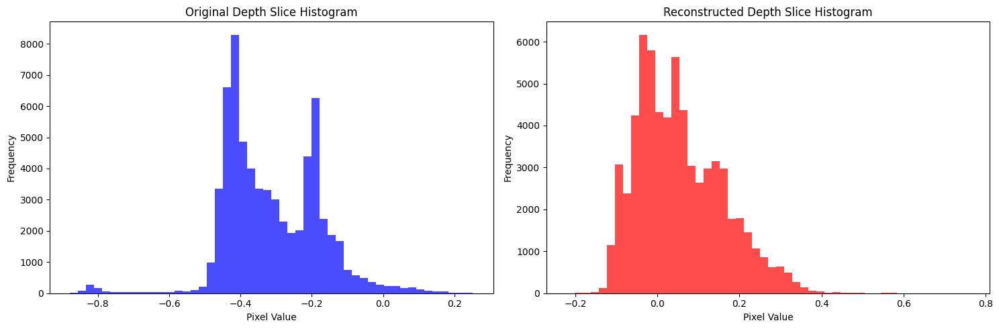

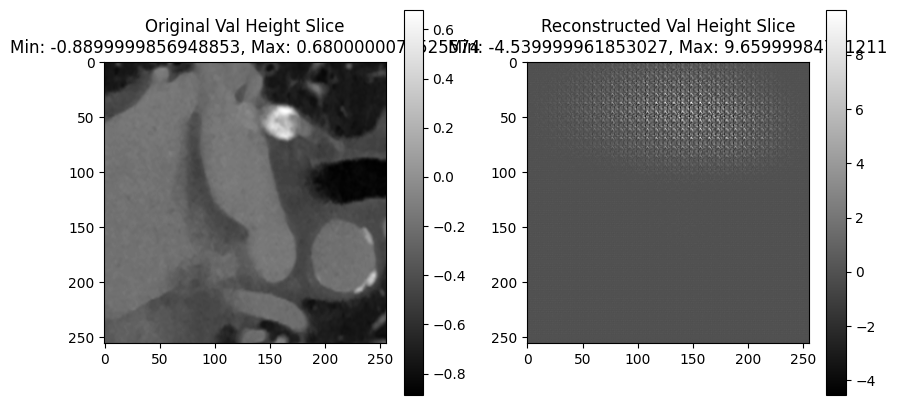

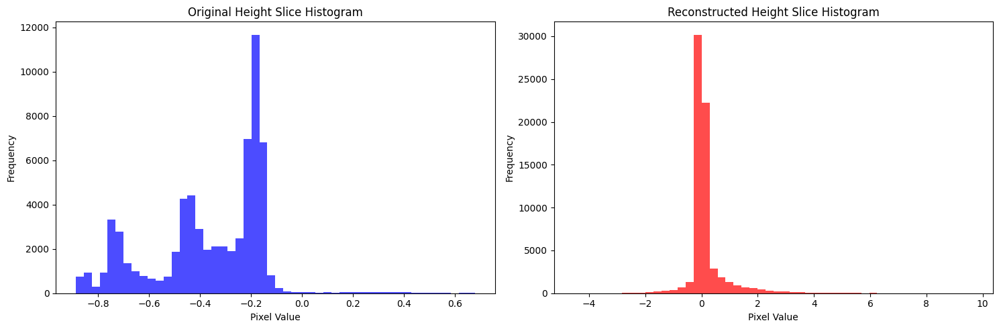

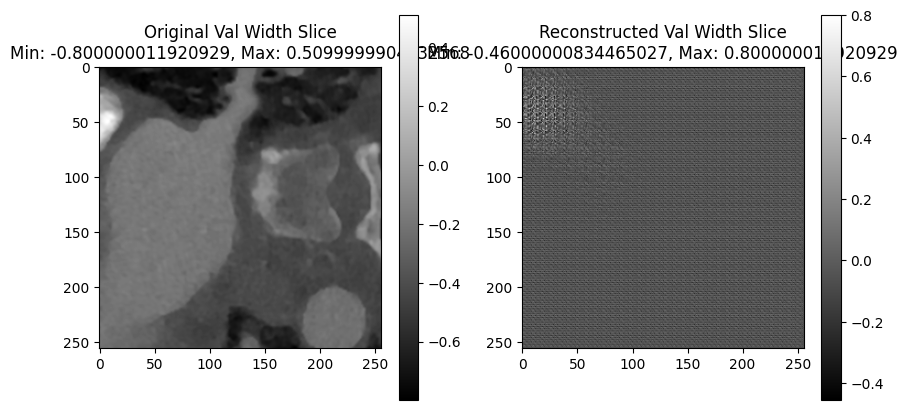

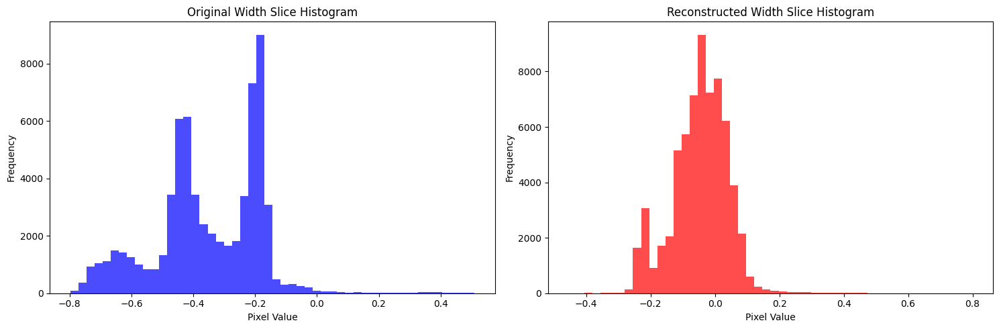

Time Spent 141.20
Epoch: 1


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 150.20
Epoch: 2


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 159.25
Epoch: 3


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 167.92
Epoch: 4


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 176.58
Epoch: 5


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 185.29
Epoch: 6


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 193.94
Epoch: 7


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 202.59
Epoch: 8


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 211.31
Epoch: 9


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 219.95
Epoch: 10


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 228.81
Epoch: 11


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 237.66
Epoch: 12


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 246.45
Epoch: 13


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 255.23
Epoch: 14


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 263.91
Epoch: 15


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 272.90
Epoch: 16


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 282.19
Epoch: 17


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 291.26
Epoch: 18


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 300.36
Epoch: 19


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 309.75
Epoch: 20


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 318.74
Epoch: 21


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 327.95
Epoch: 22


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 337.20
Epoch: 23


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 346.82
Epoch: 24


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 355.83
Epoch: 25


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 364.99
Epoch: 26


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 374.26
Epoch: 27


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 383.34
Epoch: 28


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 392.54
Epoch: 29


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 401.69
Epoch: 30


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 411.11
Epoch: 31


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 420.34
Epoch: 32


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 429.53
Epoch: 33


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 438.81
Epoch: 34


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 447.94
Epoch: 35


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 457.01
Epoch: 36


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 466.26
Epoch: 37


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 475.67
Epoch: 38


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 484.78
Epoch: 39


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 494.27
Epoch: 40


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 503.92
Epoch: 41


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 513.56
Epoch: 42


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 522.95
Epoch: 43


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 532.07
Epoch: 44


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 541.29
Epoch: 45


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 550.70
Epoch: 46


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 559.75
Epoch: 47


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 569.19
Epoch: 48


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 578.27
Epoch: 49


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 587.51
Epoch: 50


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 597.02
Epoch: 51


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 606.16
Epoch: 52


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 615.45
Epoch: 53


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 624.85
Epoch: 54


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 634.15
Epoch: 55


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 643.48
Epoch: 56


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 652.63
Epoch: 57


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 661.93
Epoch: 58


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 671.08
Epoch: 59


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 680.33
Epoch: 60


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 689.40
Epoch: 61


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 698.80
Epoch: 62


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 707.78
Epoch: 63


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 716.98
Epoch: 64


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 726.41
Epoch: 65


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 735.61
Epoch: 66


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 744.89
Epoch: 67


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 754.10
Epoch: 68


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 763.38
Epoch: 69


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 772.60
Epoch: 70


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 781.91
Epoch: 71


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 791.22
Epoch: 72


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 800.52
Epoch: 73


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 809.67
Epoch: 74


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 818.83
Epoch: 75


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 828.30
Epoch: 76


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 837.58
Epoch: 77


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 846.69
Epoch: 78


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 856.07
Epoch: 79


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 865.15
Epoch: 80


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 874.48
Epoch: 81


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 883.56
Epoch: 82


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 892.81
Epoch: 83


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 902.22
Epoch: 84


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 911.28
Epoch: 85


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 920.60
Epoch: 86


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 929.85
Epoch: 87


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 938.95
Epoch: 88


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 948.05
Epoch: 89


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 957.33
Epoch: 90


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 966.47
Epoch: 91


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 975.72
Epoch: 92


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 984.98
Epoch: 93


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 994.27
Epoch: 94


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1003.49
Epoch: 95


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1012.58
Epoch: 96


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1021.89
Epoch: 97


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1031.04
Epoch: 98


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1040.21
Epoch: 99


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1049.25
Epoch: 100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1058.58
Epoch: 101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1067.69
Epoch: 102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1076.82
Epoch: 103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1086.12
Epoch: 104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1095.19
Epoch: 105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1104.48
Epoch: 106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1113.82
Epoch: 107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1122.89
Epoch: 108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1132.36
Epoch: 109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1141.50
Epoch: 110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1150.68
Epoch: 111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1159.83
Epoch: 112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1168.97
Epoch: 113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1178.14
Epoch: 114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1187.47
Epoch: 115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1196.64
Epoch: 116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1205.85
Epoch: 117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1215.13
Epoch: 118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1224.17
Epoch: 119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1233.46
Epoch: 120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1242.73
Epoch: 121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1252.04
Epoch: 122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1261.14
Epoch: 123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1270.35
Epoch: 124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1279.67
Epoch: 125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1288.88
Epoch: 126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1298.27
Epoch: 127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1307.68
Epoch: 128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1317.45
Epoch: 129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1327.06
Epoch: 130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1336.75
Epoch: 131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1346.52
Epoch: 132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1356.22
Epoch: 133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1365.61
Epoch: 134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1374.72
Epoch: 135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1384.06
Epoch: 136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1393.64
Epoch: 137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1402.98
Epoch: 138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1412.47
Epoch: 139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1421.70
Epoch: 140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1431.17
Epoch: 141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1440.29
Epoch: 142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1449.91
Epoch: 143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1458.90
Epoch: 144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1468.12
Epoch: 145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1477.69
Epoch: 146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1487.09
Epoch: 147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1496.84
Epoch: 148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1506.17
Epoch: 149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1515.68
Epoch: 150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1525.20
Epoch: 151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1534.93
Epoch: 152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1544.20
Epoch: 153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1553.38
Epoch: 154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1562.67
Epoch: 155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1571.80
Epoch: 156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1581.02
Epoch: 157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1590.15
Epoch: 158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1599.67
Epoch: 159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1608.83
Epoch: 160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1617.91
Epoch: 161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1627.40
Epoch: 162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1636.52
Epoch: 163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1645.56
Epoch: 164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1654.69
Epoch: 165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1663.74
Epoch: 166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1673.37
Epoch: 167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1682.37
Epoch: 168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1691.82
Epoch: 169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1700.87
Epoch: 170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1709.86
Epoch: 171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1718.96
Epoch: 172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1728.07
Epoch: 173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1737.06
Epoch: 174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1746.12
Epoch: 175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1755.12
Epoch: 176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1764.11
Epoch: 177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1773.18
Epoch: 178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1782.17
Epoch: 179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1791.16
Epoch: 180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1800.22
Epoch: 181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1809.17
Epoch: 182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1818.50
Epoch: 183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1827.88
Epoch: 184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1837.47
Epoch: 185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1846.98
Epoch: 186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1856.03
Epoch: 187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1865.64
Epoch: 188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1874.40
Epoch: 189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1883.09
Epoch: 190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1891.73
Epoch: 191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1900.44
Epoch: 192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1909.14
Epoch: 193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1917.79
Epoch: 194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1926.85
Epoch: 195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1935.49
Epoch: 196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1944.16
Epoch: 197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1952.86
Epoch: 198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1961.60
Epoch: 199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1970.89
Epoch: 200


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1979.97
Epoch: 201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1988.62
Epoch: 202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 1997.33
Epoch: 203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2006.01
Epoch: 204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2014.67
Epoch: 205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2023.40
Epoch: 206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2032.43
Epoch: 207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2041.47
Epoch: 208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2050.70
Epoch: 209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2059.68
Epoch: 210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2068.99
Epoch: 211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2078.18
Epoch: 212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2087.11
Epoch: 213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2096.42
Epoch: 214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2105.08
Epoch: 215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2113.74
Epoch: 216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2122.44
Epoch: 217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2131.12
Epoch: 218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2139.77
Epoch: 219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2148.50
Epoch: 220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2157.15
Epoch: 221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2165.81
Epoch: 222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2174.51
Epoch: 223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2183.17
Epoch: 224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2191.89
Epoch: 225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2200.57
Epoch: 226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2209.49
Epoch: 227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2218.23
Epoch: 228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2226.88
Epoch: 229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2235.53
Epoch: 230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2244.32
Epoch: 231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2253.44
Epoch: 232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2262.69
Epoch: 233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2271.85
Epoch: 234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2280.89
Epoch: 235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2290.11
Epoch: 236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2299.55
Epoch: 237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2308.62
Epoch: 238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2317.71
Epoch: 239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2327.23
Epoch: 240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2336.83
Epoch: 241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2346.23
Epoch: 242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2355.70
Epoch: 243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2365.21
Epoch: 244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2374.68
Epoch: 245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2384.28
Epoch: 246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2393.48
Epoch: 247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2402.63
Epoch: 248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2411.90
Epoch: 249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2421.11
Epoch: 250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2430.25
Epoch: 251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2439.61
Epoch: 252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2448.67
Epoch: 253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2458.37
Epoch: 254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2467.39
Epoch: 255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2476.28
Epoch: 256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2484.99
Epoch: 257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2493.65
Epoch: 258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2504.02
Epoch: 259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2512.69
Epoch: 260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2521.33
Epoch: 261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2530.07
Epoch: 262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2538.72
Epoch: 263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2547.44
Epoch: 264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2556.12
Epoch: 265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2564.98
Epoch: 266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2573.71
Epoch: 267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2582.38
Epoch: 268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2591.04
Epoch: 269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2599.77
Epoch: 270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2608.61
Epoch: 271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2617.70
Epoch: 272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2626.81
Epoch: 273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2636.09
Epoch: 274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2645.11
Epoch: 275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2654.40
Epoch: 276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2663.67
Epoch: 277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2673.55
Epoch: 278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2682.84
Epoch: 279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2691.85
Epoch: 280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2701.50
Epoch: 281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2710.67
Epoch: 282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2720.07
Epoch: 283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2729.20
Epoch: 284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2738.01
Epoch: 285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2746.66
Epoch: 286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2755.51
Epoch: 287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2764.23
Epoch: 288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2773.21
Epoch: 289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2782.44
Epoch: 290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2791.66
Epoch: 291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2800.95
Epoch: 292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2810.08
Epoch: 293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2818.82
Epoch: 294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2827.86
Epoch: 295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2836.84
Epoch: 296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2845.84
Epoch: 297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2854.88
Epoch: 298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2863.95
Epoch: 299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2873.01
Epoch: 300


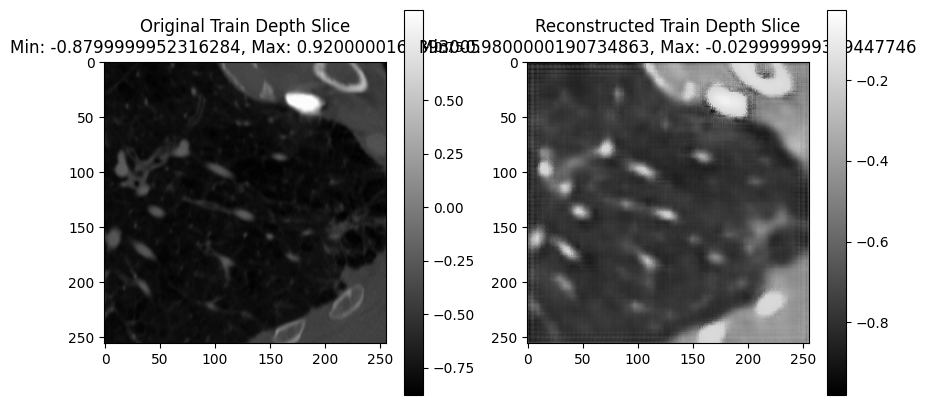

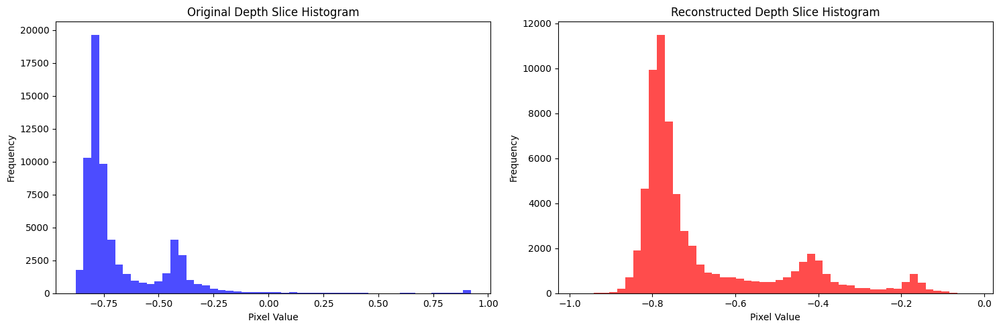

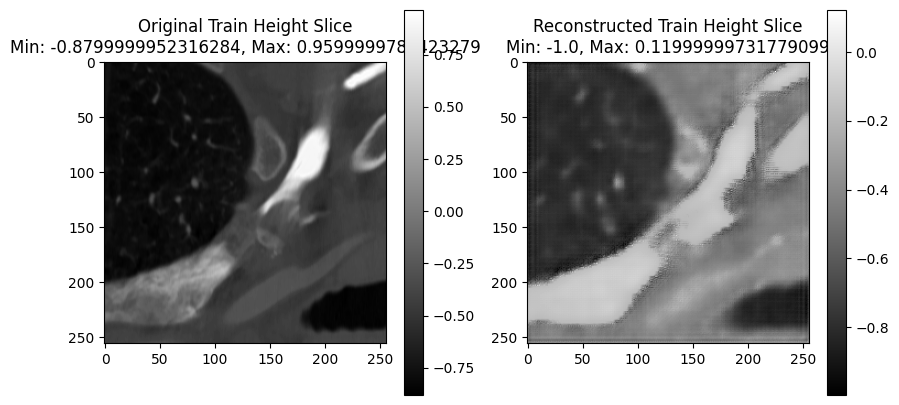

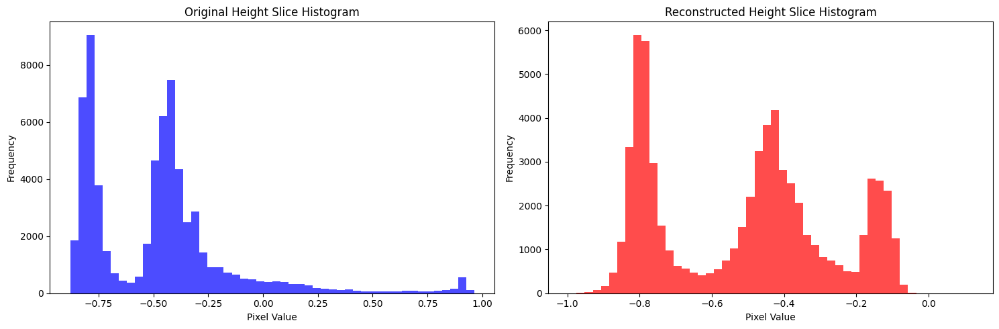

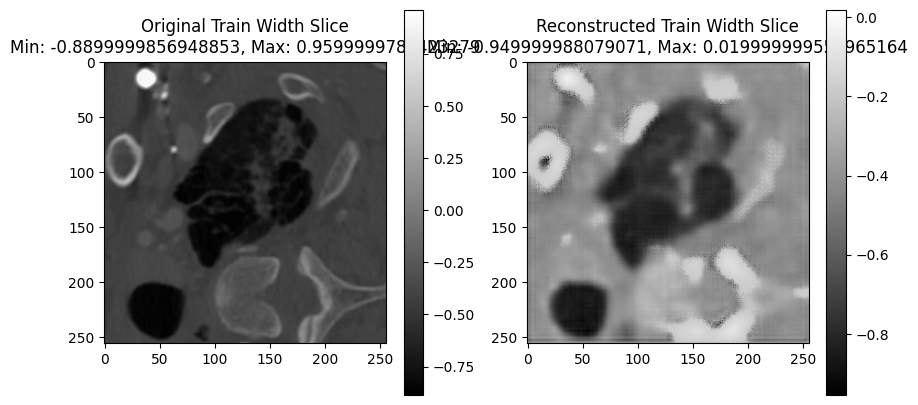

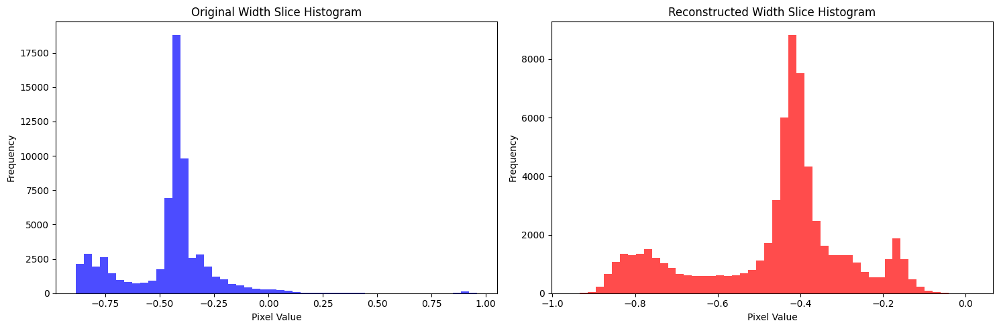

Validation: |          | 0/? [00:00<?, ?it/s]

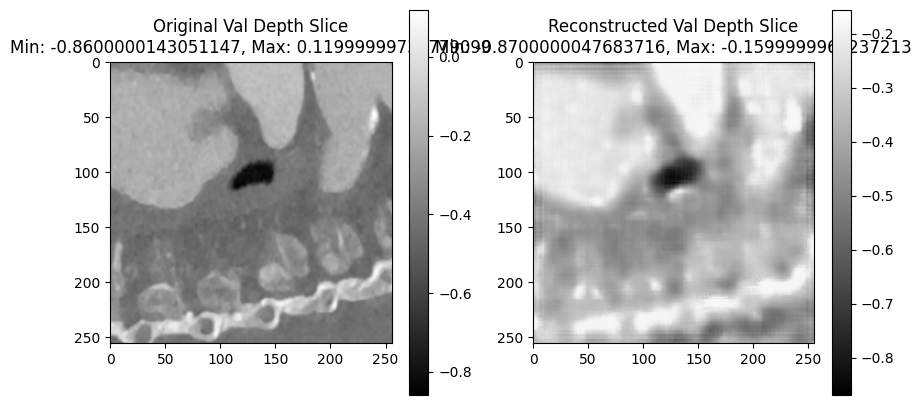

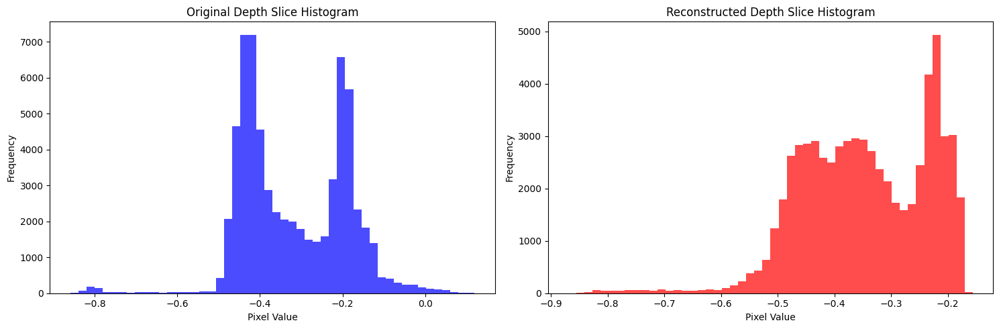

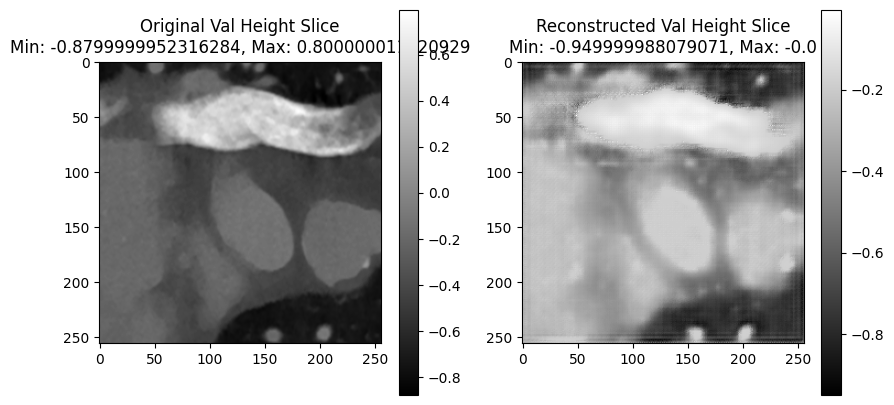

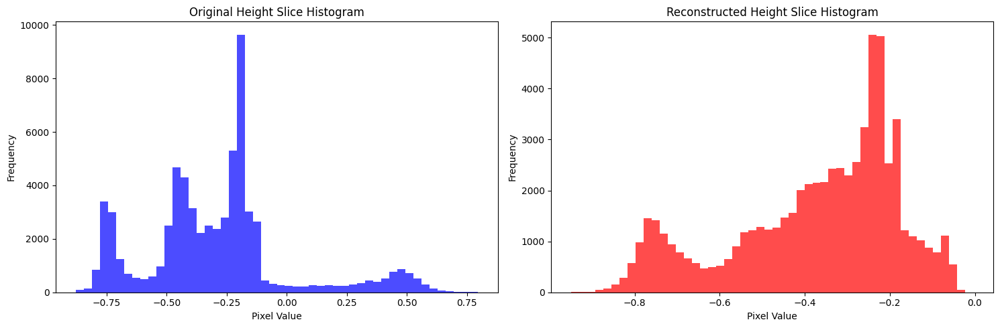

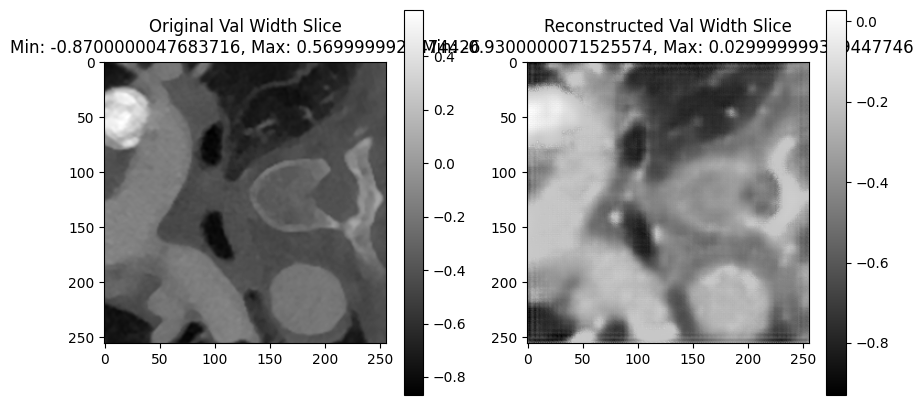

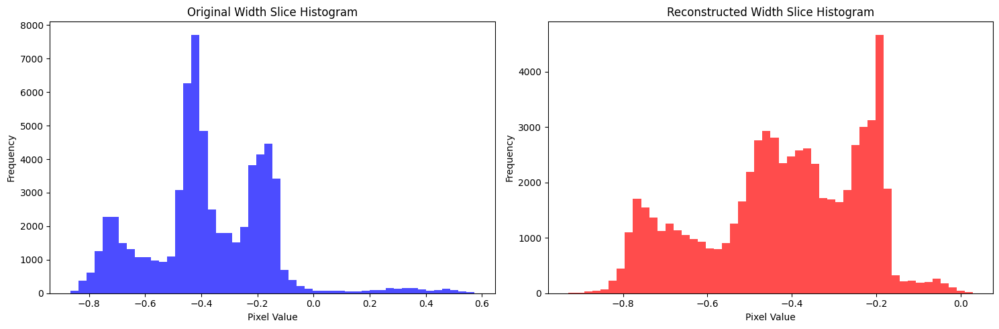

Time Spent 2889.14
Epoch: 301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2898.14
Epoch: 302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2907.19
Epoch: 303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2916.18
Epoch: 304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2925.17
Epoch: 305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2934.45
Epoch: 306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2943.78
Epoch: 307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2953.43
Epoch: 308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2962.56
Epoch: 309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2971.74
Epoch: 310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2980.94
Epoch: 311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2990.20
Epoch: 312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 2999.30
Epoch: 313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3008.44
Epoch: 314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3017.74
Epoch: 315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3026.80
Epoch: 316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3036.09
Epoch: 317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3045.04
Epoch: 318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3054.42
Epoch: 319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3064.05
Epoch: 320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3073.14
Epoch: 321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3082.44
Epoch: 322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3091.74
Epoch: 323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3100.80
Epoch: 324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3110.04
Epoch: 325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3119.25
Epoch: 326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3128.49
Epoch: 327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3137.54
Epoch: 328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3146.81
Epoch: 329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3155.77
Epoch: 330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3165.01
Epoch: 331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3174.11
Epoch: 332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3183.25
Epoch: 333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3192.66
Epoch: 334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3201.64
Epoch: 335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3210.93
Epoch: 336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3220.12
Epoch: 337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3229.68
Epoch: 338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3238.73
Epoch: 339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3247.89
Epoch: 340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3257.14
Epoch: 341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3266.31
Epoch: 342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3275.64
Epoch: 343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3284.72
Epoch: 344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3294.06
Epoch: 345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3303.07
Epoch: 346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3312.29
Epoch: 347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3321.55
Epoch: 348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3330.70
Epoch: 349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3339.79
Epoch: 350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3349.02
Epoch: 351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3358.18
Epoch: 352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3367.36
Epoch: 353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3376.73
Epoch: 354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3386.23
Epoch: 355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3395.89
Epoch: 356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3405.19
Epoch: 357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3414.55
Epoch: 358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3424.16
Epoch: 359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3433.63
Epoch: 360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3443.10
Epoch: 361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3452.74
Epoch: 362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3462.06
Epoch: 363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3471.53
Epoch: 364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3480.73
Epoch: 365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3490.01
Epoch: 366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3499.19
Epoch: 367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3508.38
Epoch: 368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3517.62
Epoch: 369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3526.85
Epoch: 370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3536.24
Epoch: 371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3545.21
Epoch: 372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3554.50
Epoch: 373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3563.67
Epoch: 374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3572.88
Epoch: 375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3582.10
Epoch: 376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3591.20
Epoch: 377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3600.31
Epoch: 378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3609.64
Epoch: 379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3618.96
Epoch: 380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3628.01
Epoch: 381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3637.83
Epoch: 382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3647.60
Epoch: 383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3656.73
Epoch: 384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3666.03
Epoch: 385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3674.87
Epoch: 386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3683.83
Epoch: 387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3692.47
Epoch: 388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3701.17
Epoch: 389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3709.82
Epoch: 390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3718.46
Epoch: 391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3727.15
Epoch: 392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3735.82
Epoch: 393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3744.65
Epoch: 394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3753.39
Epoch: 395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3762.08
Epoch: 396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3770.74
Epoch: 397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3779.44
Epoch: 398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3788.14
Epoch: 399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3796.89
Epoch: 400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3805.90
Epoch: 401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3814.55
Epoch: 402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3823.43
Epoch: 403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3832.49
Epoch: 404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3841.61
Epoch: 405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3850.88
Epoch: 406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3859.84
Epoch: 407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3869.08
Epoch: 408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3878.15
Epoch: 409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3887.36
Epoch: 410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3896.52
Epoch: 411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3905.70
Epoch: 412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3914.98
Epoch: 413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3924.01
Epoch: 414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3933.38
Epoch: 415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3942.53
Epoch: 416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3951.63
Epoch: 417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3960.88
Epoch: 418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3969.85
Epoch: 419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3979.19
Epoch: 420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3988.20
Epoch: 421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 3997.46
Epoch: 422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4006.55
Epoch: 423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4015.66
Epoch: 424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4024.83
Epoch: 425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4034.19
Epoch: 426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4043.48
Epoch: 427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4052.50
Epoch: 428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4061.80
Epoch: 429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4070.95
Epoch: 430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4080.14
Epoch: 431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4089.35
Epoch: 432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4098.56
Epoch: 433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4107.75
Epoch: 434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4116.89
Epoch: 435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4126.11
Epoch: 436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4135.41
Epoch: 437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4144.10
Epoch: 438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4153.09
Epoch: 439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4161.77
Epoch: 440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4170.41
Epoch: 441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4179.13
Epoch: 442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4187.78
Epoch: 443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4196.45
Epoch: 444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4205.56
Epoch: 445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4214.43
Epoch: 446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4223.41
Epoch: 447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4232.44
Epoch: 448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4241.43
Epoch: 449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4250.55
Epoch: 450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4259.52
Epoch: 451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4268.51
Epoch: 452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4277.97
Epoch: 453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4286.96
Epoch: 454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4295.94
Epoch: 455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4304.83
Epoch: 456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4313.49
Epoch: 457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4322.18
Epoch: 458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4331.34
Epoch: 459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4340.06
Epoch: 460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4349.32
Epoch: 461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4358.03
Epoch: 462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4366.71
Epoch: 463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4375.43
Epoch: 464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4384.08
Epoch: 465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4392.76
Epoch: 466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4401.48
Epoch: 467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4410.14
Epoch: 468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4418.87
Epoch: 469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4427.87
Epoch: 470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4436.85
Epoch: 471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4445.83
Epoch: 472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4454.63
Epoch: 473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4463.28
Epoch: 474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4472.01
Epoch: 475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4480.67
Epoch: 476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4489.47
Epoch: 477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4498.54
Epoch: 478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4507.83
Epoch: 479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4517.00
Epoch: 480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4526.28
Epoch: 481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4535.41
Epoch: 482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4544.78
Epoch: 483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4553.81
Epoch: 484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4563.02
Epoch: 485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4572.19
Epoch: 486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4581.58
Epoch: 487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4590.81
Epoch: 488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4599.87
Epoch: 489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4609.47
Epoch: 490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4618.94
Epoch: 491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4628.46
Epoch: 492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4637.85
Epoch: 493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4647.21
Epoch: 494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4656.49
Epoch: 495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4665.61
Epoch: 496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4674.98
Epoch: 497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4684.20
Epoch: 498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4693.33
Epoch: 499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4702.50
Epoch: 500


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4711.83
Epoch: 501


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4721.06
Epoch: 502


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4730.53
Epoch: 503


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4739.82
Epoch: 504


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4748.91
Epoch: 505


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4758.19
Epoch: 506


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4767.29
Epoch: 507


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4776.11
Epoch: 508


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4785.63
Epoch: 509


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4794.89
Epoch: 510


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4803.86
Epoch: 511


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4813.15
Epoch: 512


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4822.15
Epoch: 513


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4831.31
Epoch: 514


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4840.33
Epoch: 515


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4849.33
Epoch: 516


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4858.08
Epoch: 517


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4866.74
Epoch: 518


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4875.38
Epoch: 519


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4884.07
Epoch: 520


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4892.72
Epoch: 521


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4901.38
Epoch: 522


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4910.07
Epoch: 523


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4918.71
Epoch: 524


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4927.77
Epoch: 525


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4936.44
Epoch: 526


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4945.35
Epoch: 527


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4954.65
Epoch: 528


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4964.27
Epoch: 529


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4973.65
Epoch: 530


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4982.84
Epoch: 531


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 4992.17
Epoch: 532


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5001.27
Epoch: 533


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5010.49
Epoch: 534


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5019.83
Epoch: 535


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5029.17
Epoch: 536


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5038.68
Epoch: 537


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5048.10
Epoch: 538


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5057.58
Epoch: 539


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5067.03
Epoch: 540


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5076.72
Epoch: 541


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5086.13
Epoch: 542


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5095.71
Epoch: 543


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5104.42
Epoch: 544


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5113.83
Epoch: 545


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5122.48
Epoch: 546


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5131.13
Epoch: 547


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5139.84
Epoch: 548


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5148.51
Epoch: 549


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5157.35
Epoch: 550


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5166.09
Epoch: 551


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5174.82
Epoch: 552


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5183.52
Epoch: 553


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5192.16
Epoch: 554


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5200.85
Epoch: 555


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5209.64
Epoch: 556


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5218.33
Epoch: 557


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5226.99
Epoch: 558


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5235.69
Epoch: 559


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5244.36
Epoch: 560


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5253.04
Epoch: 561


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5261.77
Epoch: 562


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5270.87
Epoch: 563


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5280.03
Epoch: 564


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5289.14
Epoch: 565


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5298.41
Epoch: 566


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5307.76
Epoch: 567


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5316.72
Epoch: 568


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5325.94
Epoch: 569


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5335.25
Epoch: 570


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5344.54
Epoch: 571


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5353.53
Epoch: 572


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5362.75
Epoch: 573


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5372.29
Epoch: 574


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5381.46
Epoch: 575


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5391.54
Epoch: 576


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5400.89
Epoch: 577


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5410.45
Epoch: 578


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5420.09
Epoch: 579


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5429.80
Epoch: 580


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5438.93
Epoch: 581


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5448.03
Epoch: 582


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5457.32
Epoch: 583


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5466.79
Epoch: 584


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5476.35
Epoch: 585


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5485.68
Epoch: 586


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5495.37
Epoch: 587


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5504.66
Epoch: 588


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5513.72
Epoch: 589


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5523.06
Epoch: 590


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5531.85
Epoch: 591


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5540.56
Epoch: 592


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5549.23
Epoch: 593


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5558.32
Epoch: 594


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5567.61
Epoch: 595


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5577.11
Epoch: 596


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5586.72
Epoch: 597


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5596.12
Epoch: 598


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5605.64
Epoch: 599


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5614.83
Epoch: 600


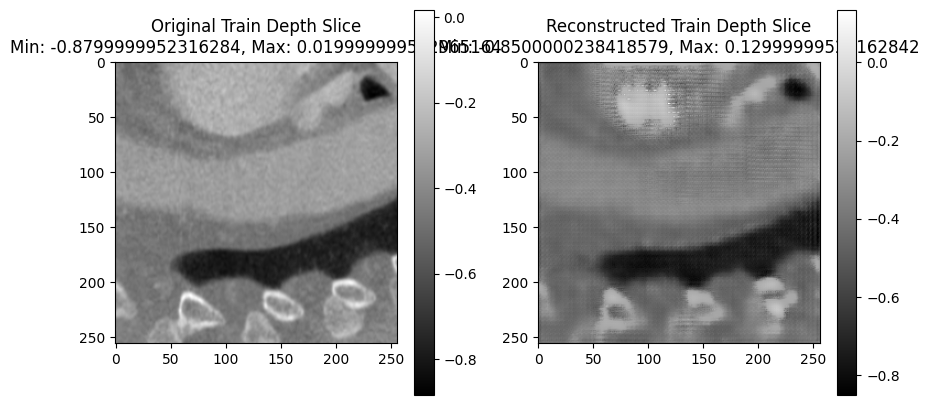

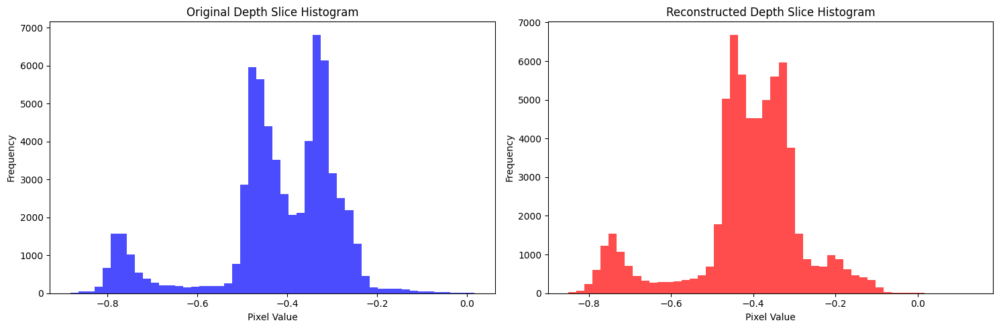

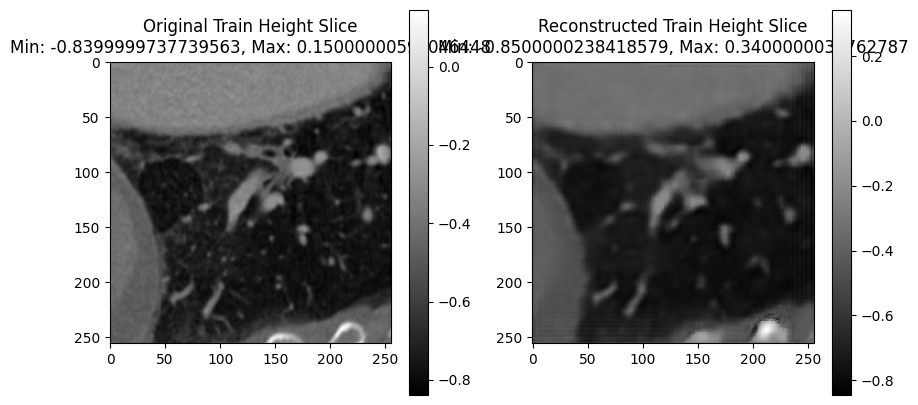

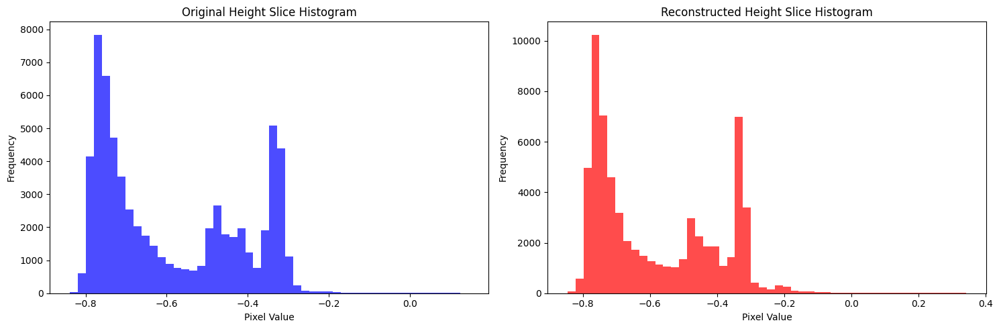

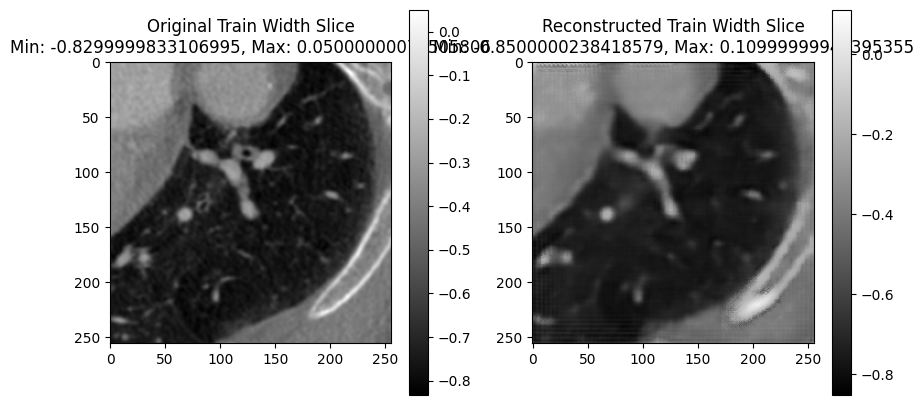

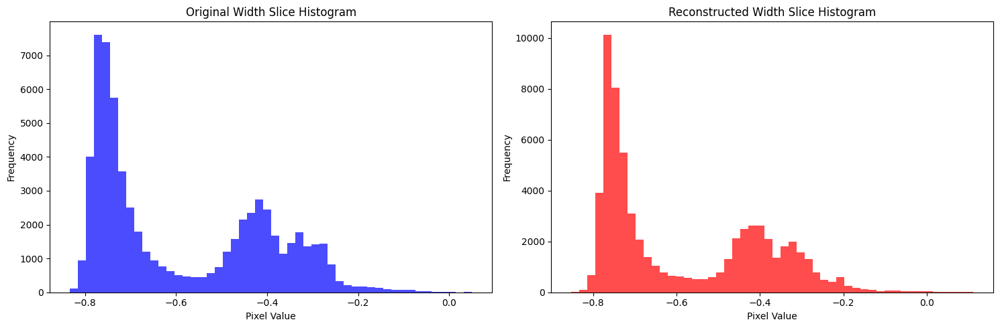

Validation: |          | 0/? [00:00<?, ?it/s]

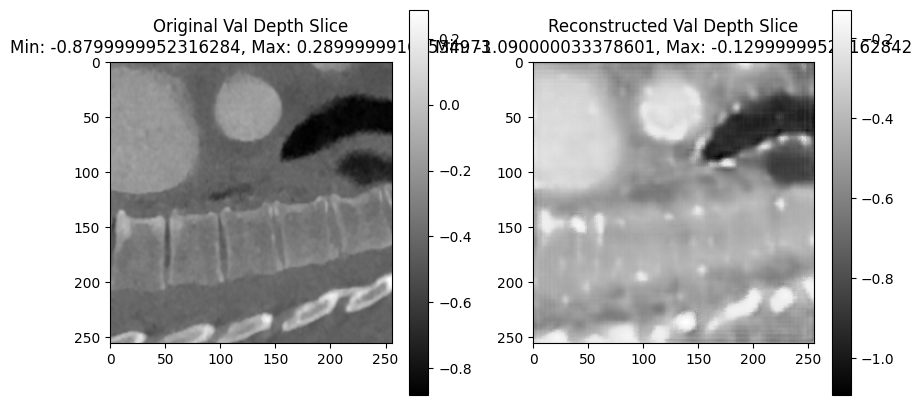

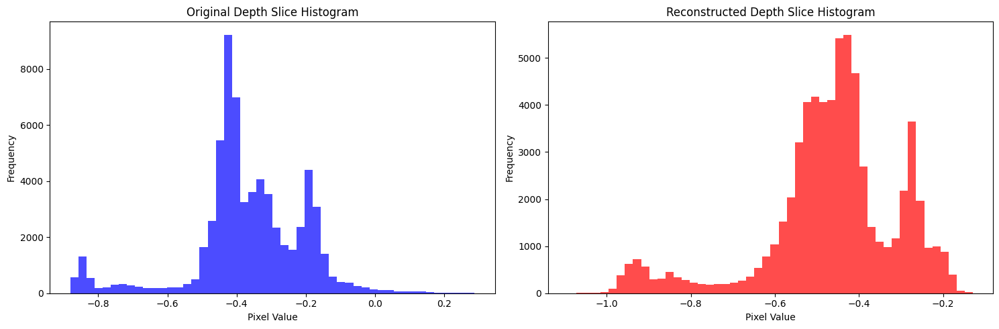

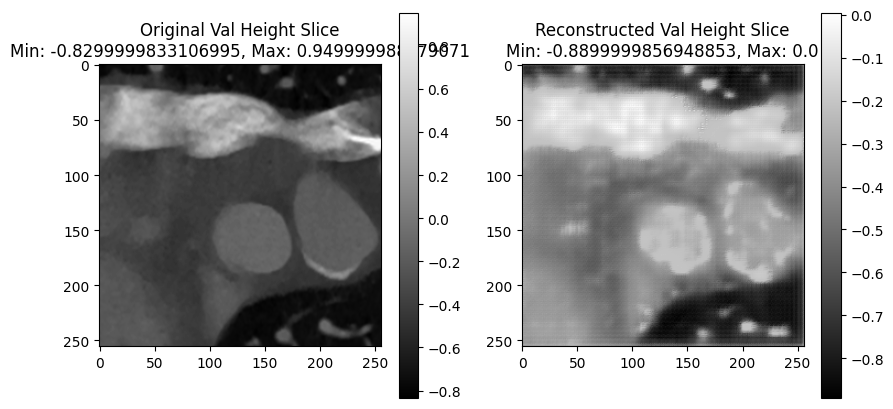

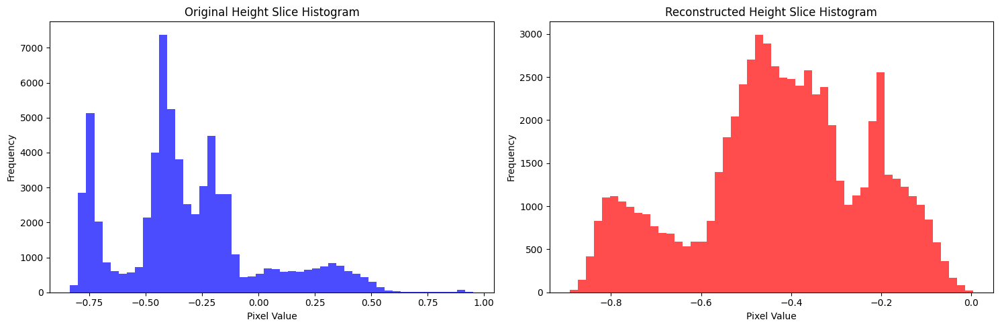

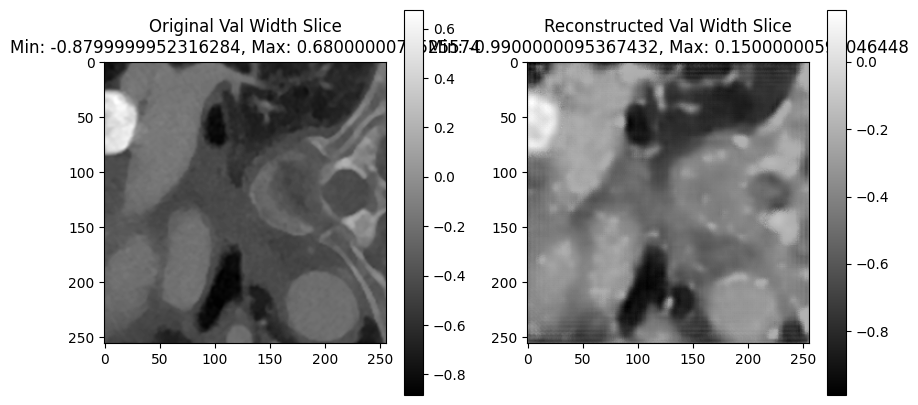

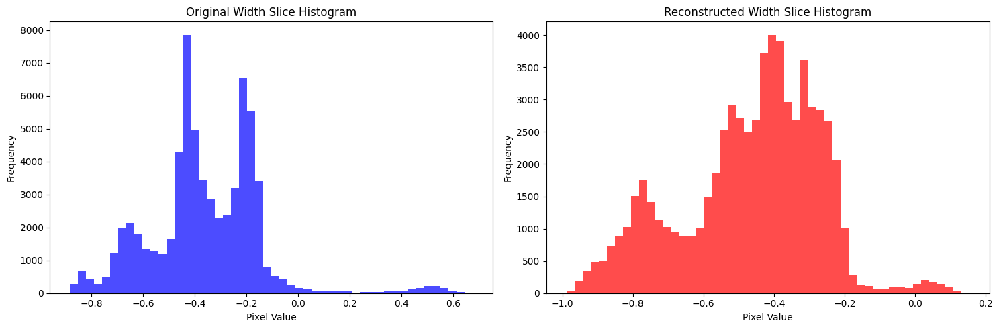

Time Spent 5631.04
Epoch: 601


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5639.70
Epoch: 602


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5648.41
Epoch: 603


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5657.11
Epoch: 604


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5665.77
Epoch: 605


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5674.53
Epoch: 606


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5683.22
Epoch: 607


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5691.88
Epoch: 608


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5700.58
Epoch: 609


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5709.26
Epoch: 610


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5717.93
Epoch: 611


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5726.66
Epoch: 612


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5735.31
Epoch: 613


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5744.22
Epoch: 614


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5753.20
Epoch: 615


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5762.18
Epoch: 616


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5771.50
Epoch: 617


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5780.67
Epoch: 618


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5789.88
Epoch: 619


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5799.14
Epoch: 620


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5808.21
Epoch: 621


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5817.50
Epoch: 622


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5826.73
Epoch: 623


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5835.94
Epoch: 624


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5845.00
Epoch: 625


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5854.34
Epoch: 626


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5863.53
Epoch: 627


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5872.61
Epoch: 628


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5881.98
Epoch: 629


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5891.11
Epoch: 630


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5900.41
Epoch: 631


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5909.40
Epoch: 632


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5918.77
Epoch: 633


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5927.97
Epoch: 634


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5937.11
Epoch: 635


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5946.37
Epoch: 636


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5955.53
Epoch: 637


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5964.69
Epoch: 638


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5973.78
Epoch: 639


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5983.20
Epoch: 640


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 5992.55
Epoch: 641


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6002.16
Epoch: 642


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6011.40
Epoch: 643


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6020.66
Epoch: 644


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6029.95
Epoch: 645


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6039.15
Epoch: 646


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6048.61
Epoch: 647


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6058.00
Epoch: 648


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6067.73
Epoch: 649


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6077.28
Epoch: 650


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6087.07
Epoch: 651


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6096.39
Epoch: 652


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6105.71
Epoch: 653


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6115.09
Epoch: 654


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6124.47
Epoch: 655


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6133.74
Epoch: 656


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6143.19
Epoch: 657


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6152.43
Epoch: 658


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6161.52
Epoch: 659


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6170.61
Epoch: 660


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6180.08
Epoch: 661


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6188.90
Epoch: 662


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6198.13
Epoch: 663


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6206.87
Epoch: 664


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6215.51
Epoch: 665


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6224.23
Epoch: 666


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6232.93
Epoch: 667


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6241.60
Epoch: 668


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6250.26
Epoch: 669


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6258.97
Epoch: 670


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6267.62
Epoch: 671


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6276.65
Epoch: 672


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6285.36
Epoch: 673


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6294.12
Epoch: 674


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6302.85
Epoch: 675


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6311.53
Epoch: 676


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6320.18
Epoch: 677


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6328.91
Epoch: 678


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6337.93
Epoch: 679


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6346.60
Epoch: 680


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6355.69
Epoch: 681


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6364.34
Epoch: 682


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6372.99
Epoch: 683


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6381.69
Epoch: 684


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6390.33
Epoch: 685


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6398.99
Epoch: 686


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6407.98
Epoch: 687


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6416.97
Epoch: 688


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6426.00
Epoch: 689


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6434.99
Epoch: 690


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6443.96
Epoch: 691


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6453.47
Epoch: 692


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6462.42
Epoch: 693


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6471.40
Epoch: 694


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6480.44
Epoch: 695


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6489.60
Epoch: 696


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6498.57
Epoch: 697


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6507.61
Epoch: 698


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6516.85
Epoch: 699


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6526.18
Epoch: 700


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6535.59
Epoch: 701


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6545.15
Epoch: 702


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6554.70
Epoch: 703


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6564.00
Epoch: 704


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6573.49
Epoch: 705


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6583.02
Epoch: 706


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6592.10
Epoch: 707


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6601.21
Epoch: 708


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6610.36
Epoch: 709


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6619.66
Epoch: 710


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6628.79
Epoch: 711


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6638.01
Epoch: 712


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6647.29
Epoch: 713


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6656.29
Epoch: 714


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6665.51
Epoch: 715


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6674.63
Epoch: 716


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6683.98
Epoch: 717


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6693.11
Epoch: 718


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6702.21
Epoch: 719


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6711.51
Epoch: 720


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6720.56
Epoch: 721


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6729.79
Epoch: 722


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6738.90
Epoch: 723


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6748.10
Epoch: 724


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6757.18
Epoch: 725


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6766.39
Epoch: 726


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6775.62
Epoch: 727


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6784.68
Epoch: 728


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6793.85
Epoch: 729


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6803.08
Epoch: 730


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6812.33
Epoch: 731


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6821.32
Epoch: 732


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6830.48
Epoch: 733


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6839.77
Epoch: 734


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6848.81
Epoch: 735


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6857.94
Epoch: 736


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6867.21
Epoch: 737


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6876.26
Epoch: 738


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6885.37
Epoch: 739


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6894.53
Epoch: 740


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6903.84
Epoch: 741


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6912.89
Epoch: 742


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6921.97
Epoch: 743


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6931.11
Epoch: 744


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6940.41
Epoch: 745


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6949.47
Epoch: 746


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6958.60
Epoch: 747


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6967.89
Epoch: 748


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6977.02
Epoch: 749


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6986.02
Epoch: 750


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 6995.15
Epoch: 751


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7004.47
Epoch: 752


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7013.50
Epoch: 753


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7022.60
Epoch: 754


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7031.86
Epoch: 755


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7041.03
Epoch: 756


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7050.08
Epoch: 757


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7059.64
Epoch: 758


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7069.35
Epoch: 759


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7078.34
Epoch: 760


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7087.49
Epoch: 761


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7096.99
Epoch: 762


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7106.14
Epoch: 763


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7115.22
Epoch: 764


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7124.37
Epoch: 765


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7133.76
Epoch: 766


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7143.22
Epoch: 767


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7152.66
Epoch: 768


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7162.16
Epoch: 769


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7171.42
Epoch: 770


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7180.62
Epoch: 771


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7189.75
Epoch: 772


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7199.04
Epoch: 773


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7208.19
Epoch: 774


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7217.37
Epoch: 775


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7226.54
Epoch: 776


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7235.55
Epoch: 777


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7244.84
Epoch: 778


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7256.93
Epoch: 779


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7265.90
Epoch: 780


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7275.00
Epoch: 781


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7284.28
Epoch: 782


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7293.66
Epoch: 783


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7302.88
Epoch: 784


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7312.23
Epoch: 785


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7321.38
Epoch: 786


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7330.63
Epoch: 787


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7339.61
Epoch: 788


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7348.76
Epoch: 789


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7358.04
Epoch: 790


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7367.08
Epoch: 791


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7376.23
Epoch: 792


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7385.37
Epoch: 793


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7394.23
Epoch: 794


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7402.93
Epoch: 795


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7411.57
Epoch: 796


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7420.23
Epoch: 797


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7428.96
Epoch: 798


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7437.62
Epoch: 799


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7446.35
Epoch: 800


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7455.39
Epoch: 801


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7464.04
Epoch: 802


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7472.92
Epoch: 803


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7481.92
Epoch: 804


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7490.90
Epoch: 805


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7499.95
Epoch: 806


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7508.93
Epoch: 807


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7517.59
Epoch: 808


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7526.30
Epoch: 809


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7534.95
Epoch: 810


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7544.08
Epoch: 811


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7553.44
Epoch: 812


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7562.95
Epoch: 813


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7572.31
Epoch: 814


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7581.55
Epoch: 815


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7590.65
Epoch: 816


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7599.93
Epoch: 817


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7609.29
Epoch: 818


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7618.27
Epoch: 819


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7627.62
Epoch: 820


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7636.83
Epoch: 821


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7646.08
Epoch: 822


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7655.23
Epoch: 823


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7664.50
Epoch: 824


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7673.53
Epoch: 825


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7682.82
Epoch: 826


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7692.04
Epoch: 827


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7701.19
Epoch: 828


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7710.69
Epoch: 829


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7719.79
Epoch: 830


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7729.11
Epoch: 831


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7738.51
Epoch: 832


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7747.56
Epoch: 833


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7756.79
Epoch: 834


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7765.99
Epoch: 835


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7775.17
Epoch: 836


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7784.51
Epoch: 837


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7793.89
Epoch: 838


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7803.52
Epoch: 839


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7812.67
Epoch: 840


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7821.32
Epoch: 841


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7830.34
Epoch: 842


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7839.13
Epoch: 843


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7848.13
Epoch: 844


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7856.87
Epoch: 845


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7865.60
Epoch: 846


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7874.24
Epoch: 847


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7883.30
Epoch: 848


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7892.19
Epoch: 849


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7901.07
Epoch: 850


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7910.04
Epoch: 851


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7919.04
Epoch: 852


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7928.09
Epoch: 853


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7937.07
Epoch: 854


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7946.02
Epoch: 855


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7955.33
Epoch: 856


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7964.86
Epoch: 857


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7974.25
Epoch: 858


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7983.80
Epoch: 859


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 7993.39
Epoch: 860


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8002.72
Epoch: 861


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8012.38
Epoch: 862


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8021.89
Epoch: 863


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8031.37
Epoch: 864


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8040.83
Epoch: 865


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8050.43
Epoch: 866


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8060.09
Epoch: 867


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8069.46
Epoch: 868


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8079.00
Epoch: 869


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8088.47
Epoch: 870


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8098.09
Epoch: 871


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8107.43
Epoch: 872


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8117.22
Epoch: 873


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8126.61
Epoch: 874


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8135.98
Epoch: 875


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8145.45
Epoch: 876


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8155.10
Epoch: 877


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8164.45
Epoch: 878


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8173.77
Epoch: 879


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8183.24
Epoch: 880


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8192.31
Epoch: 881


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8201.44
Epoch: 882


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8210.58
Epoch: 883


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8219.86
Epoch: 884


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8229.13
Epoch: 885


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8238.15
Epoch: 886


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8247.50
Epoch: 887


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8256.56
Epoch: 888


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8265.61
Epoch: 889


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8274.72
Epoch: 890


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8283.85
Epoch: 891


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8293.12
Epoch: 892


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8302.15
Epoch: 893


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8311.50
Epoch: 894


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8320.61
Epoch: 895


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8329.40
Epoch: 896


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8338.05
Epoch: 897


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8346.76
Epoch: 898


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8355.83
Epoch: 899


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8364.85
Epoch: 900


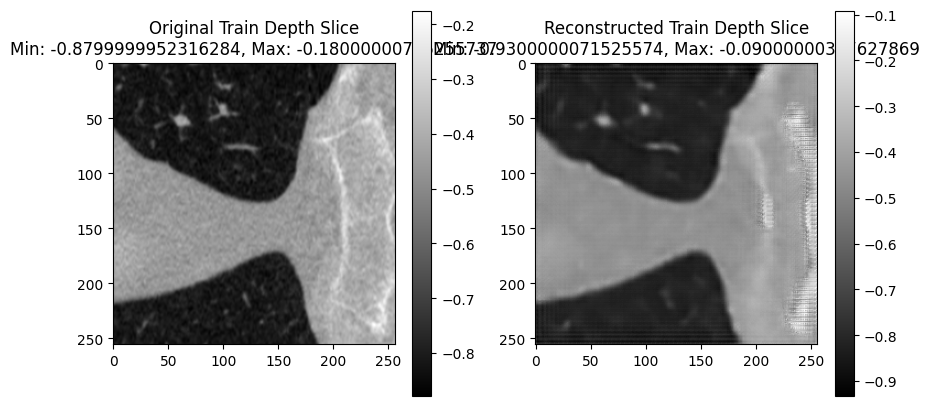

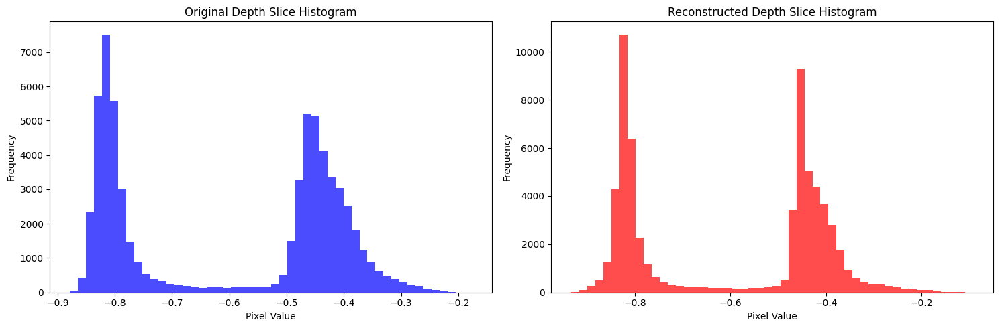

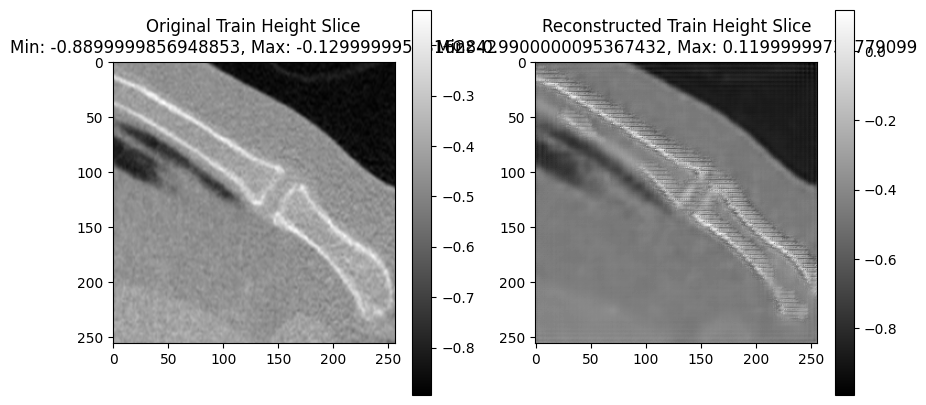

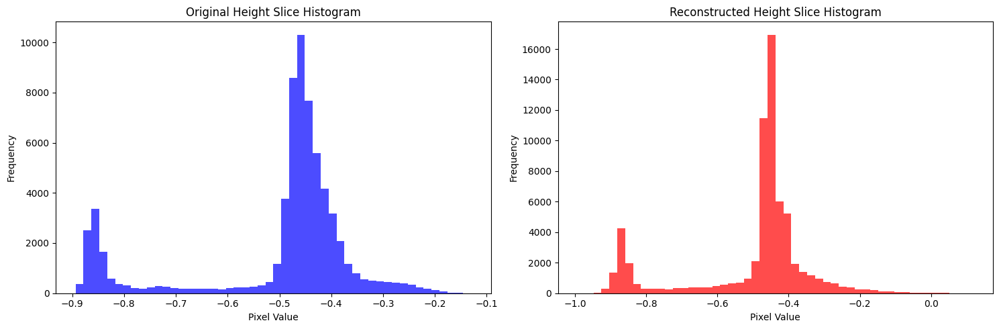

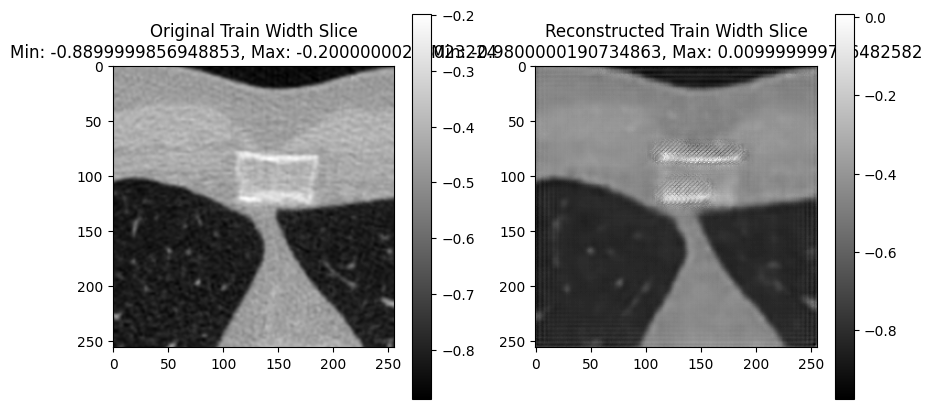

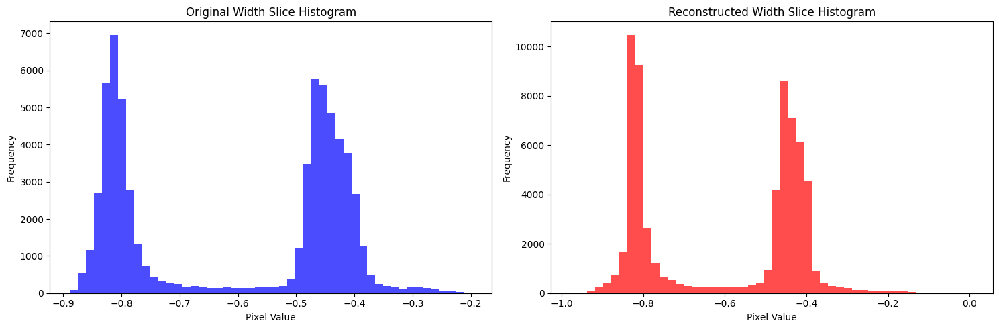

Validation: |          | 0/? [00:00<?, ?it/s]

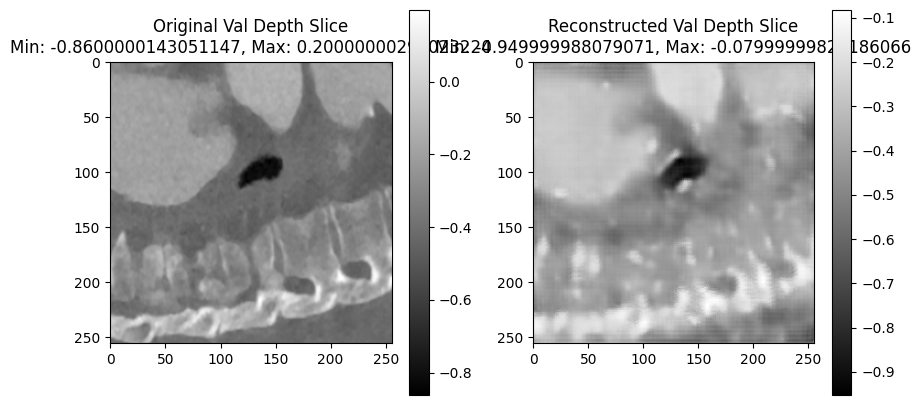

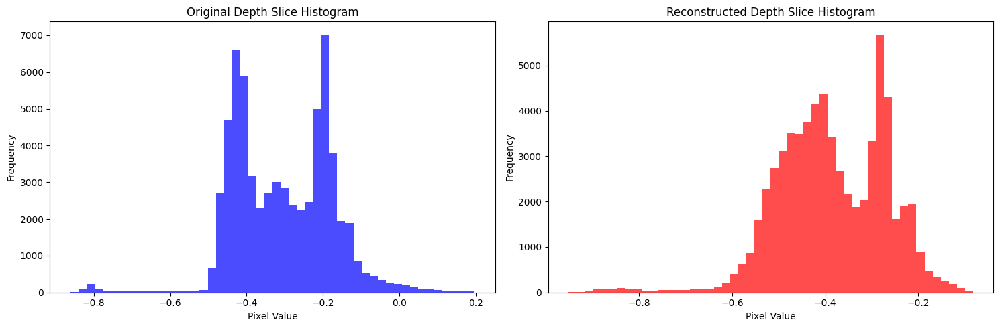

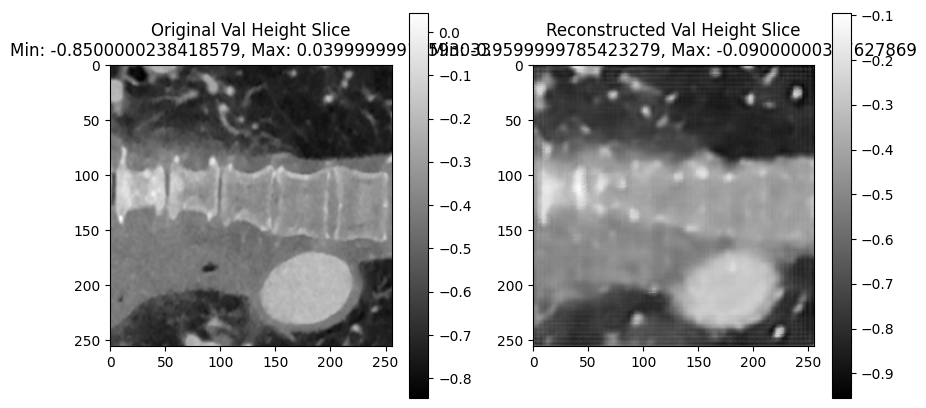

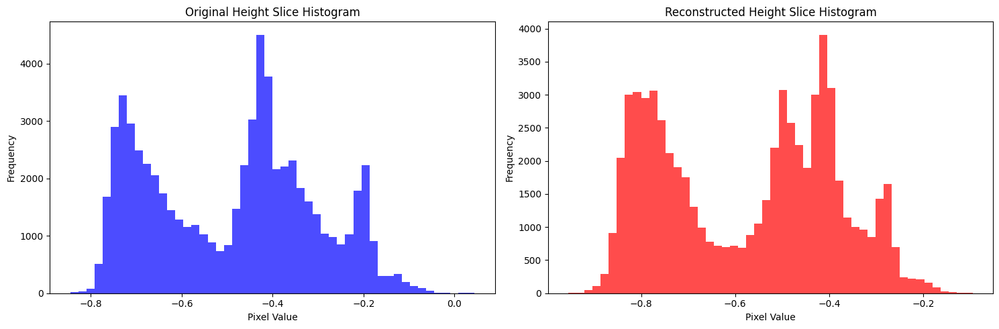

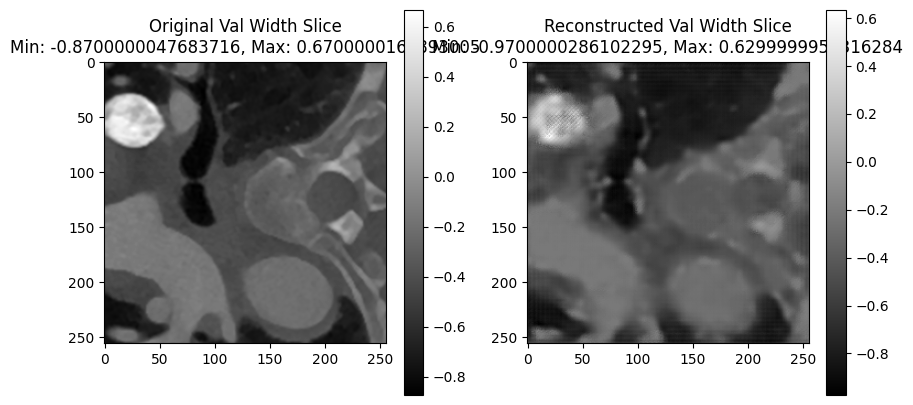

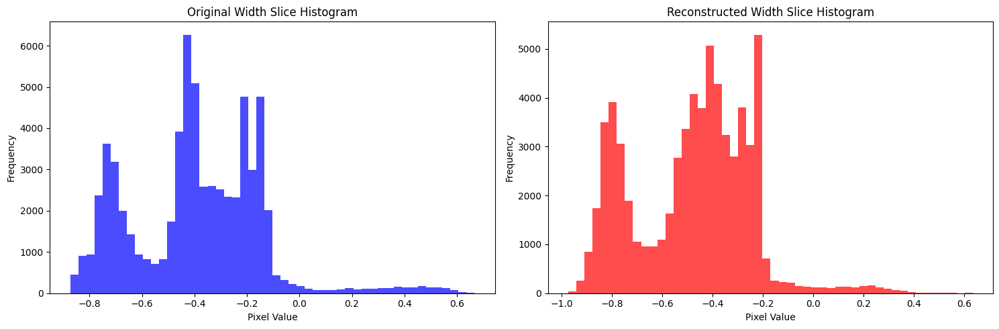

Time Spent 8380.30
Epoch: 901


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8389.07
Epoch: 902


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8397.83
Epoch: 903


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8406.50
Epoch: 904


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8415.17
Epoch: 905


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8423.89
Epoch: 906


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8432.55
Epoch: 907


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8441.20
Epoch: 908


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8449.91
Epoch: 909


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8458.56
Epoch: 910


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8467.23
Epoch: 911


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8475.95
Epoch: 912


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8484.60
Epoch: 913


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8493.30
Epoch: 914


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8502.03
Epoch: 915


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8511.03
Epoch: 916


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8520.18
Epoch: 917


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8529.41
Epoch: 918


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8538.38
Epoch: 919


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8547.71
Epoch: 920


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8556.69
Epoch: 921


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8566.02
Epoch: 922


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8575.10
Epoch: 923


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8584.23
Epoch: 924


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8593.34
Epoch: 925


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8602.55
Epoch: 926


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8611.68
Epoch: 927


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8620.79
Epoch: 928


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8630.47
Epoch: 929


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8639.82
Epoch: 930


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8649.42
Epoch: 931


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8658.54
Epoch: 932


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8667.70
Epoch: 933


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8677.03
Epoch: 934


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8685.78
Epoch: 935


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8696.78
Epoch: 936


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8705.48
Epoch: 937


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8714.14
Epoch: 938


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8722.84
Epoch: 939


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8731.55
Epoch: 940


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8740.20
Epoch: 941


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8748.94
Epoch: 942


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8757.60
Epoch: 943


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8766.27
Epoch: 944


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8774.97
Epoch: 945


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8783.63
Epoch: 946


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8792.29
Epoch: 947


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8801.02
Epoch: 948


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8809.77
Epoch: 949


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8819.09
Epoch: 950


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8828.01
Epoch: 951


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8836.71
Epoch: 952


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8845.68
Epoch: 953


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8854.99
Epoch: 954


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8864.39
Epoch: 955


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8873.57
Epoch: 956


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8882.94
Epoch: 957


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8891.98
Epoch: 958


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8900.85
Epoch: 959


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8910.35
Epoch: 960


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8919.01
Epoch: 961


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8927.99
Epoch: 962


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8936.70
Epoch: 963


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8945.42
Epoch: 964


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8954.07
Epoch: 965


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8962.72
Epoch: 966


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8971.43
Epoch: 967


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8980.08
Epoch: 968


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8988.72
Epoch: 969


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 8997.50
Epoch: 970


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9006.15
Epoch: 971


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9015.30
Epoch: 972


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9024.33
Epoch: 973


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9033.14
Epoch: 974


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9041.85
Epoch: 975


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9050.84
Epoch: 976


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9059.54
Epoch: 977


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9068.27
Epoch: 978


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9076.91
Epoch: 979


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9085.56
Epoch: 980


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9094.26
Epoch: 981


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9103.05
Epoch: 982


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9112.05
Epoch: 983


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9121.12
Epoch: 984


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9130.12
Epoch: 985


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9139.14
Epoch: 986


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9148.54
Epoch: 987


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9157.95
Epoch: 988


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9167.30
Epoch: 989


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9177.03
Epoch: 990


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9186.52
Epoch: 991


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9196.03
Epoch: 992


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9205.44
Epoch: 993


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9215.07
Epoch: 994


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9224.32
Epoch: 995


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9233.65
Epoch: 996


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9242.99
Epoch: 997


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9252.33
Epoch: 998


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9261.36
Epoch: 999


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9270.23
Epoch: 1000


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9279.25
Epoch: 1001


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9287.93
Epoch: 1002


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9296.63
Epoch: 1003


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9305.28
Epoch: 1004


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9313.93
Epoch: 1005


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9322.64
Epoch: 1006


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9331.29
Epoch: 1007


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9339.95
Epoch: 1008


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9348.94
Epoch: 1009


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9357.91
Epoch: 1010


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9366.88
Epoch: 1011


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9375.91
Epoch: 1012


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9384.88
Epoch: 1013


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9393.92
Epoch: 1014


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9402.81
Epoch: 1015


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9411.62
Epoch: 1016


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9420.65
Epoch: 1017


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9429.95
Epoch: 1018


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9439.20
Epoch: 1019


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9448.38
Epoch: 1020


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9457.42
Epoch: 1021


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9466.55
Epoch: 1022


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9475.82
Epoch: 1023


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9485.12
Epoch: 1024


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9494.22
Epoch: 1025


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9503.14
Epoch: 1026


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9512.39
Epoch: 1027


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9521.16
Epoch: 1028


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9529.82
Epoch: 1029


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9538.60
Epoch: 1030


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9547.30
Epoch: 1031


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9555.95
Epoch: 1032


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9564.60
Epoch: 1033


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9573.37
Epoch: 1034


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9582.05
Epoch: 1035


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9590.95
Epoch: 1036


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9599.99
Epoch: 1037


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9608.97
Epoch: 1038


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9618.04
Epoch: 1039


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9627.02
Epoch: 1040


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9636.00
Epoch: 1041


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9645.13
Epoch: 1042


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9654.10
Epoch: 1043


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9663.08
Epoch: 1044


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9672.12
Epoch: 1045


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9681.19
Epoch: 1046


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9690.74
Epoch: 1047


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9700.21
Epoch: 1048


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9709.55
Epoch: 1049


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9719.20
Epoch: 1050


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9728.51
Epoch: 1051


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9737.75
Epoch: 1052


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9746.72
Epoch: 1053


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9756.09
Epoch: 1054


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9765.12
Epoch: 1055


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9774.33
Epoch: 1056


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9783.55
Epoch: 1057


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9792.60
Epoch: 1058


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9801.93
Epoch: 1059


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9811.10
Epoch: 1060


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9820.28
Epoch: 1061


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9829.36
Epoch: 1062


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9838.64
Epoch: 1063


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9847.87
Epoch: 1064


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9856.96
Epoch: 1065


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9866.15
Epoch: 1066


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9875.40
Epoch: 1067


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9884.91
Epoch: 1068


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9893.90
Epoch: 1069


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9903.23
Epoch: 1070


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9912.28
Epoch: 1071


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9921.47
Epoch: 1072


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9930.74
Epoch: 1073


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9940.06
Epoch: 1074


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9949.11
Epoch: 1075


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9958.30
Epoch: 1076


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9967.42
Epoch: 1077


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9976.57
Epoch: 1078


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9985.38
Epoch: 1079


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 9994.36
Epoch: 1080


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10003.08
Epoch: 1081


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10011.77
Epoch: 1082


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10020.44
Epoch: 1083


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10029.15
Epoch: 1084


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10037.80
Epoch: 1085


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10046.44
Epoch: 1086


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10055.15
Epoch: 1087


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10063.87
Epoch: 1088


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10072.61
Epoch: 1089


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10081.27
Epoch: 1090


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10089.92
Epoch: 1091


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10098.62
Epoch: 1092


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10107.28
Epoch: 1093


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10115.94
Epoch: 1094


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10124.82
Epoch: 1095


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10133.81
Epoch: 1096


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10143.21
Epoch: 1097


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10152.79
Epoch: 1098


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10162.12
Epoch: 1099


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10171.71
Epoch: 1100


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10181.21
Epoch: 1101


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10190.88
Epoch: 1102


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10200.21
Epoch: 1103


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10209.67
Epoch: 1104


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10219.22
Epoch: 1105


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10228.72
Epoch: 1106


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10238.16
Epoch: 1107


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10247.54
Epoch: 1108


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10257.25
Epoch: 1109


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10266.70
Epoch: 1110


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10275.71
Epoch: 1111


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10285.30
Epoch: 1112


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10294.87
Epoch: 1113


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10304.20
Epoch: 1114


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10313.31
Epoch: 1115


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10322.60
Epoch: 1116


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10331.73
Epoch: 1117


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10340.94
Epoch: 1118


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10350.07
Epoch: 1119


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10359.41
Epoch: 1120


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10368.48
Epoch: 1121


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10377.64
Epoch: 1122


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10387.05
Epoch: 1123


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10396.26
Epoch: 1124


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10405.24
Epoch: 1125


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10414.41
Epoch: 1126


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10423.72
Epoch: 1127


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10433.18
Epoch: 1128


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10442.73
Epoch: 1129


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10452.25
Epoch: 1130


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10461.74
Epoch: 1131


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10471.05
Epoch: 1132


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10480.50
Epoch: 1133


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10490.04
Epoch: 1134


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10499.56
Epoch: 1135


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10508.97
Epoch: 1136


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10518.62
Epoch: 1137


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10527.94
Epoch: 1138


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10537.36
Epoch: 1139


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10546.87
Epoch: 1140


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10556.36
Epoch: 1141


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10566.03
Epoch: 1142


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10575.03
Epoch: 1143


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10584.48
Epoch: 1144


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10593.60
Epoch: 1145


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10602.70
Epoch: 1146


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10611.81
Epoch: 1147


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10621.01
Epoch: 1148


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10630.11
Epoch: 1149


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10639.35
Epoch: 1150


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10648.77
Epoch: 1151


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10657.72
Epoch: 1152


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10666.88
Epoch: 1153


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10676.13
Epoch: 1154


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10685.26
Epoch: 1155


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10694.60
Epoch: 1156


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10703.64
Epoch: 1157


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10713.00
Epoch: 1158


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10722.04
Epoch: 1159


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10731.44
Epoch: 1160


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10740.92
Epoch: 1161


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10750.50
Epoch: 1162


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10759.97
Epoch: 1163


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10769.33
Epoch: 1164


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10779.02
Epoch: 1165


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10788.40
Epoch: 1166


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10797.88
Epoch: 1167


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10807.38
Epoch: 1168


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10816.73
Epoch: 1169


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10826.29
Epoch: 1170


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10836.19
Epoch: 1171


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10845.88
Epoch: 1172


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10855.32
Epoch: 1173


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10864.61
Epoch: 1174


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10874.08
Epoch: 1175


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10883.59
Epoch: 1176


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10892.80
Epoch: 1177


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10901.91
Epoch: 1178


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10911.57
Epoch: 1179


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10921.00
Epoch: 1180


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10930.44
Epoch: 1181


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10939.84
Epoch: 1182


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10949.31
Epoch: 1183


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10958.97
Epoch: 1184


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10968.03
Epoch: 1185


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10977.40
Epoch: 1186


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10986.45
Epoch: 1187


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 10995.60
Epoch: 1188


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11004.65
Epoch: 1189


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11014.14
Epoch: 1190


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11023.61
Epoch: 1191


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11033.24
Epoch: 1192


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11042.75
Epoch: 1193


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11052.06
Epoch: 1194


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11061.63
Epoch: 1195


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11071.04
Epoch: 1196


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11080.56
Epoch: 1197


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11089.71
Epoch: 1198


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11098.94
Epoch: 1199


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11108.02
Epoch: 1200


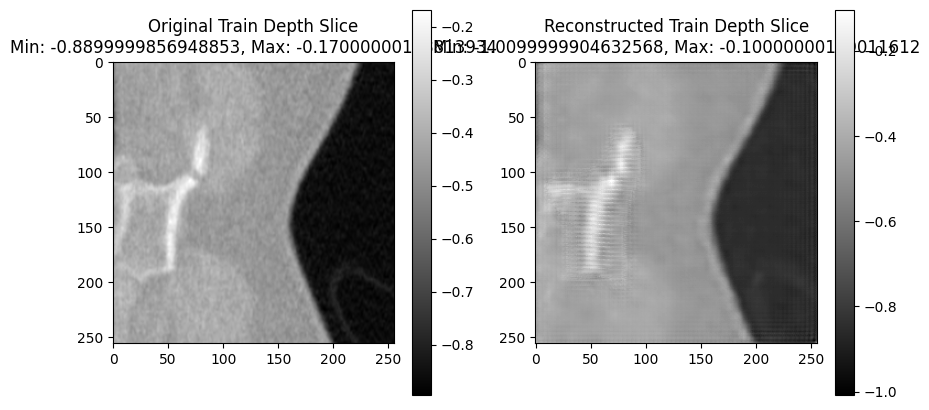

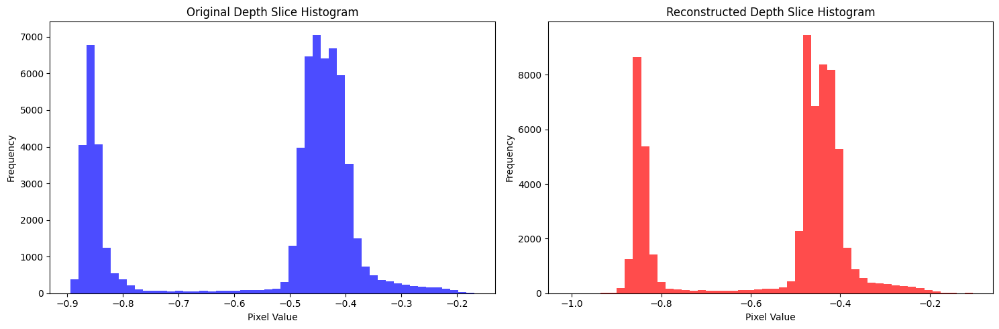

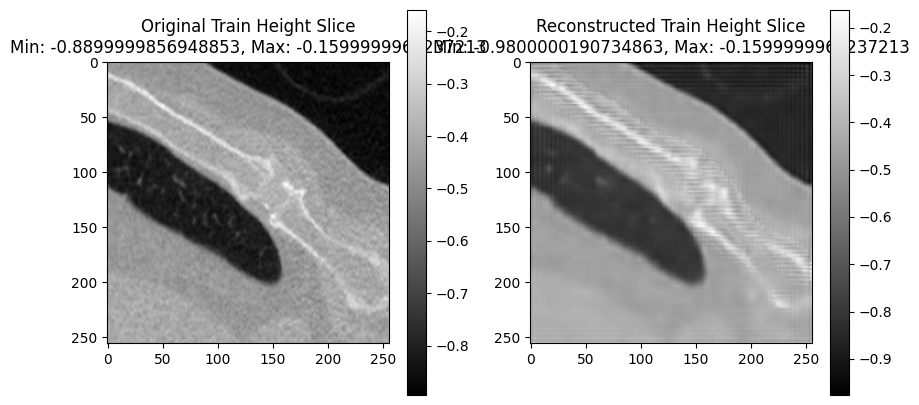

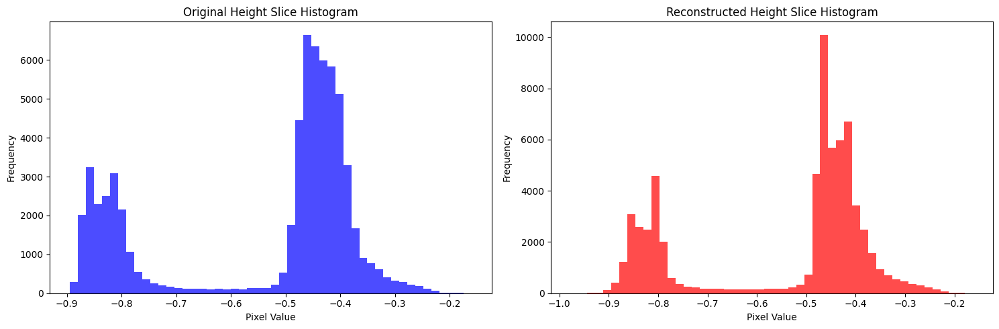

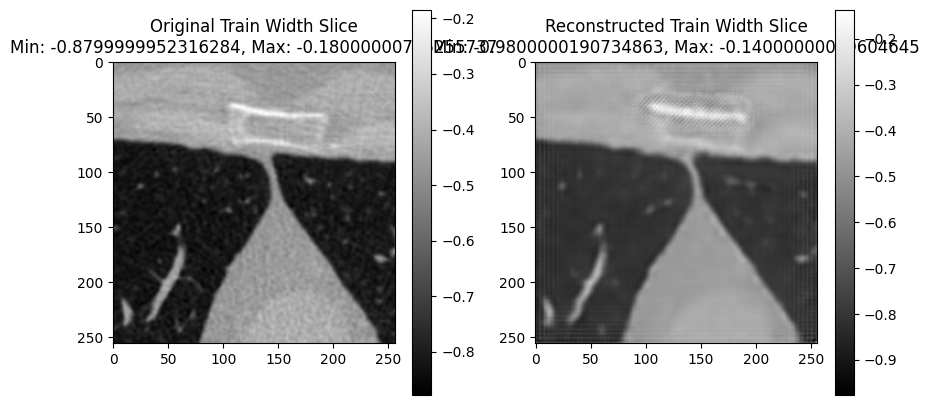

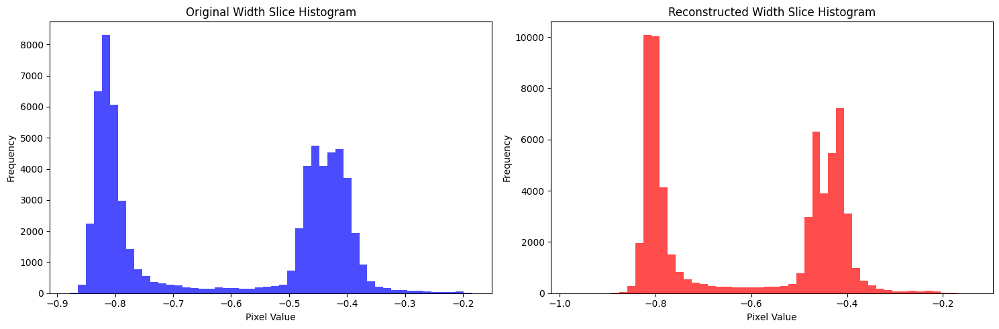

Validation: |          | 0/? [00:00<?, ?it/s]

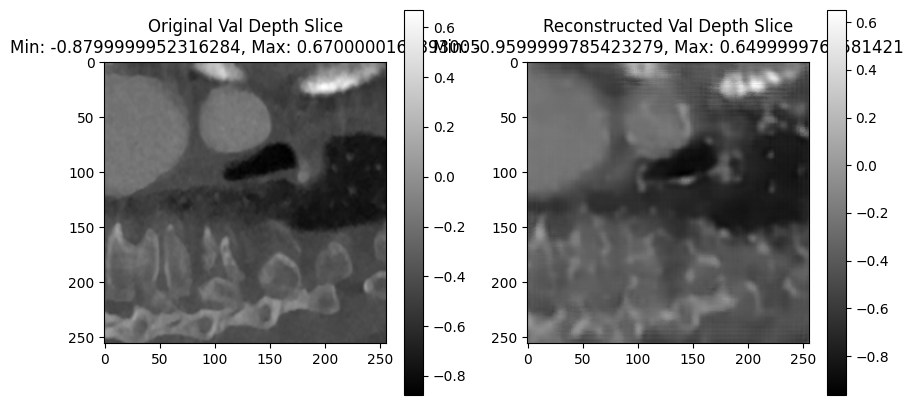

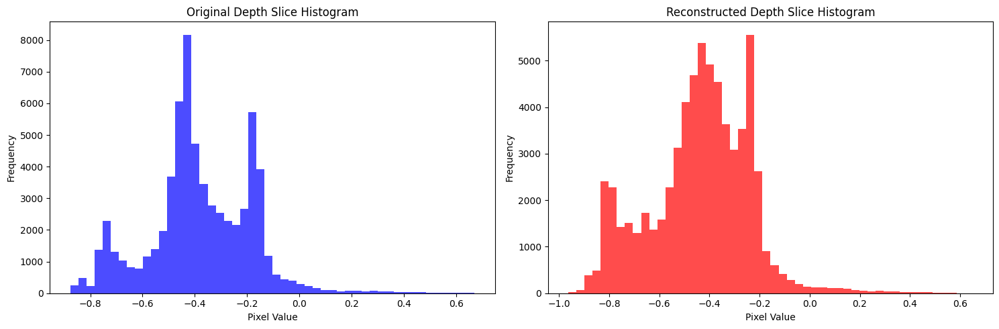

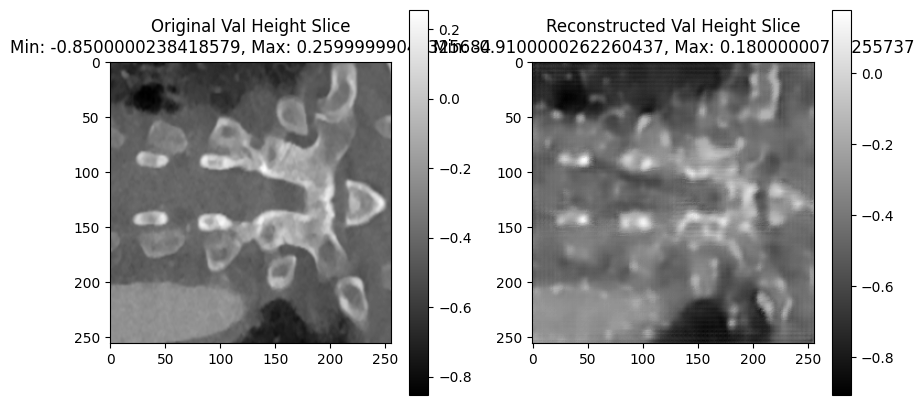

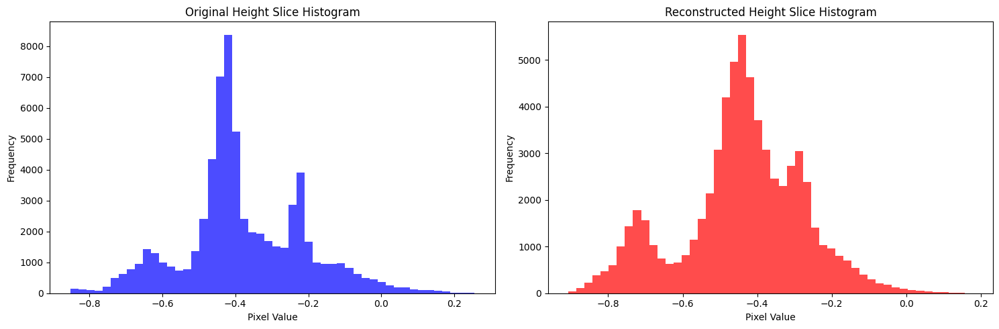

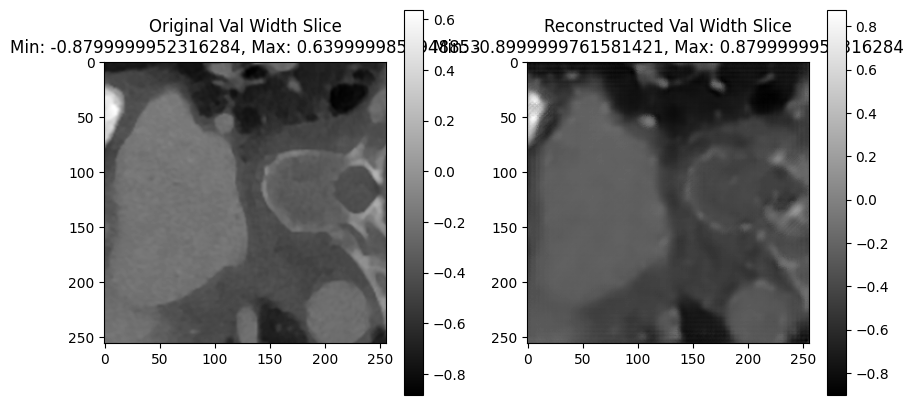

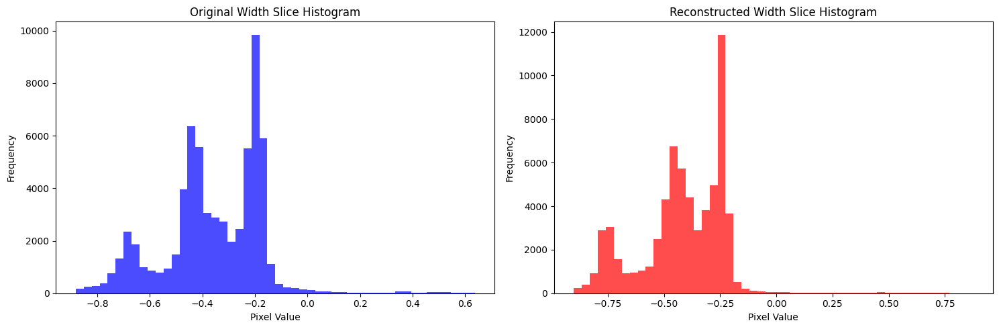

Time Spent 11124.13
Epoch: 1201


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11133.01
Epoch: 1202


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11142.04
Epoch: 1203


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11150.71
Epoch: 1204


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11159.38
Epoch: 1205


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11168.08
Epoch: 1206


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11176.73
Epoch: 1207


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11185.40
Epoch: 1208


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11194.10
Epoch: 1209


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11202.80
Epoch: 1210


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11211.49
Epoch: 1211


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11220.20
Epoch: 1212


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11228.86
Epoch: 1213


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11237.67
Epoch: 1214


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11246.30
Epoch: 1215


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11254.95
Epoch: 1216


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11263.78
Epoch: 1217


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11273.16
Epoch: 1218


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11282.93
Epoch: 1219


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11292.59
Epoch: 1220


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11301.81
Epoch: 1221


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11311.16
Epoch: 1222


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11320.37
Epoch: 1223


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11329.84
Epoch: 1224


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11339.30
Epoch: 1225


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11348.81
Epoch: 1226


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11358.54
Epoch: 1227


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11368.18
Epoch: 1228


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11377.62
Epoch: 1229


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11386.90
Epoch: 1230


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11396.59
Epoch: 1231


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11405.98
Epoch: 1232


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11415.59
Epoch: 1233


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11424.61
Epoch: 1234


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11433.72
Epoch: 1235


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11442.93
Epoch: 1236


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11452.92
Epoch: 1237


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11462.10
Epoch: 1238


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11471.30
Epoch: 1239


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11480.81
Epoch: 1240


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11489.86
Epoch: 1241


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11499.11
Epoch: 1242


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11508.62
Epoch: 1243


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11517.83
Epoch: 1244


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11526.98
Epoch: 1245


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11536.25
Epoch: 1246


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11545.47
Epoch: 1247


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11554.52
Epoch: 1248


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11563.74
Epoch: 1249


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11573.07
Epoch: 1250


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11582.40
Epoch: 1251


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11591.52
Epoch: 1252


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11600.80
Epoch: 1253


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11610.44
Epoch: 1254


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11619.47
Epoch: 1255


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11628.88
Epoch: 1256


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11638.42
Epoch: 1257


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11648.02
Epoch: 1258


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11657.54
Epoch: 1259


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11666.97
Epoch: 1260


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11676.61
Epoch: 1261


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11685.95
Epoch: 1262


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11695.42
Epoch: 1263


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11704.98
Epoch: 1264


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11714.50
Epoch: 1265


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11723.99
Epoch: 1266


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11733.45
Epoch: 1267


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11742.83
Epoch: 1268


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11752.00
Epoch: 1269


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11761.11
Epoch: 1270


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11770.28
Epoch: 1271


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11779.70
Epoch: 1272


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11788.93
Epoch: 1273


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11798.28
Epoch: 1274


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11807.51
Epoch: 1275


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11817.05
Epoch: 1276


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11826.47
Epoch: 1277


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11835.98
Epoch: 1278


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11845.46
Epoch: 1279


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11854.42
Epoch: 1280


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11863.80
Epoch: 1281


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11873.08
Epoch: 1282


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11882.05
Epoch: 1283


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11891.09
Epoch: 1284


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11900.06
Epoch: 1285


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11909.03
Epoch: 1286


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11918.07
Epoch: 1287


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11927.04
Epoch: 1288


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11936.07
Epoch: 1289


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11945.04
Epoch: 1290


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11954.01
Epoch: 1291


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11963.22
Epoch: 1292


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11972.20
Epoch: 1293


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11981.13
Epoch: 1294


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11989.86
Epoch: 1295


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 11998.51
Epoch: 1296


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12007.16
Epoch: 1297


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12015.92
Epoch: 1298


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12024.92
Epoch: 1299


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12034.21
Epoch: 1300


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12043.68
Epoch: 1301


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12052.89
Epoch: 1302


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12062.21
Epoch: 1303


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12071.69
Epoch: 1304


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12081.14
Epoch: 1305


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12090.66
Epoch: 1306


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12100.19
Epoch: 1307


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12109.70
Epoch: 1308


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12119.06
Epoch: 1309


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12128.31
Epoch: 1310


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12137.32
Epoch: 1311


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12146.15
Epoch: 1312


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12154.82
Epoch: 1313


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12163.65
Epoch: 1314


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12172.64
Epoch: 1315


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12181.62
Epoch: 1316


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12190.36
Epoch: 1317


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12199.02
Epoch: 1318


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12207.67
Epoch: 1319


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12216.45
Epoch: 1320


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12225.10
Epoch: 1321


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12233.76
Epoch: 1322


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12242.48
Epoch: 1323


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12251.13
Epoch: 1324


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12259.85
Epoch: 1325


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12268.51
Epoch: 1326


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12277.16
Epoch: 1327


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12286.12
Epoch: 1328


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12295.33
Epoch: 1329


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12304.65
Epoch: 1330


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12314.30
Epoch: 1331


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12323.62
Epoch: 1332


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12333.14
Epoch: 1333


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12342.64
Epoch: 1334


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12351.87
Epoch: 1335


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12361.02
Epoch: 1336


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12370.28
Epoch: 1337


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12379.56
Epoch: 1338


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12388.55
Epoch: 1339


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12397.34
Epoch: 1340


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12406.86
Epoch: 1341


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12415.90
Epoch: 1342


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12424.91
Epoch: 1343


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12433.88
Epoch: 1344


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12442.98
Epoch: 1345


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12451.96
Epoch: 1346


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12460.96
Epoch: 1347


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12469.73
Epoch: 1348


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12478.39
Epoch: 1349


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12487.10
Epoch: 1350


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12495.75
Epoch: 1351


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12504.43
Epoch: 1352


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12513.21
Epoch: 1353


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12521.94
Epoch: 1354


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12530.62
Epoch: 1355


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12539.33
Epoch: 1356


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12547.99
Epoch: 1357


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12556.64
Epoch: 1358


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12565.67
Epoch: 1359


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12574.65
Epoch: 1360


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12583.90
Epoch: 1361


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12593.38
Epoch: 1362


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12603.02
Epoch: 1363


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12612.00
Epoch: 1364


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12621.16
Epoch: 1365


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12630.56
Epoch: 1366


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12639.61
Epoch: 1367


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12648.84
Epoch: 1368


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12658.01
Epoch: 1369


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12667.31
Epoch: 1370


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12676.40
Epoch: 1371


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12685.54
Epoch: 1372


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12694.90
Epoch: 1373


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12704.07
Epoch: 1374


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12713.27
Epoch: 1375


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12722.76
Epoch: 1376


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12732.24
Epoch: 1377


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12741.90
Epoch: 1378


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12751.38
Epoch: 1379


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12760.25
Epoch: 1380


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12769.86
Epoch: 1381


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12778.68
Epoch: 1382


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12787.34
Epoch: 1383


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12796.05
Epoch: 1384


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12804.99
Epoch: 1385


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12813.97
Epoch: 1386


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12823.02
Epoch: 1387


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12832.00
Epoch: 1388


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12841.06
Epoch: 1389


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12850.05
Epoch: 1390


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12859.05
Epoch: 1391


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12868.46
Epoch: 1392


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12877.45
Epoch: 1393


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12886.24
Epoch: 1394


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12895.07
Epoch: 1395


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12904.06
Epoch: 1396


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12913.05
Epoch: 1397


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12922.08
Epoch: 1398


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12931.06
Epoch: 1399


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12940.37
Epoch: 1400


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12949.82
Epoch: 1401


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12959.12
Epoch: 1402


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12968.63
Epoch: 1403


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12978.09
Epoch: 1404


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12987.67
Epoch: 1405


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 12997.21
Epoch: 1406


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13006.61
Epoch: 1407


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13015.77
Epoch: 1408


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13024.50
Epoch: 1409


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13033.21
Epoch: 1410


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13041.87
Epoch: 1411


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13050.57
Epoch: 1412


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13059.25
Epoch: 1413


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13068.01
Epoch: 1414


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13076.78
Epoch: 1415


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13085.45
Epoch: 1416


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13094.16
Epoch: 1417


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13102.81
Epoch: 1418


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13111.49
Epoch: 1419


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13120.21
Epoch: 1420


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13129.14
Epoch: 1421


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13138.13
Epoch: 1422


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13146.85
Epoch: 1423


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13155.49
Epoch: 1424


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13164.48
Epoch: 1425


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13173.63
Epoch: 1426


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13183.00
Epoch: 1427


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13192.63
Epoch: 1428


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13202.30
Epoch: 1429


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13211.49
Epoch: 1430


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13220.85
Epoch: 1431


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13230.06
Epoch: 1432


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13239.41
Epoch: 1433


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13248.66
Epoch: 1434


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13257.91
Epoch: 1435


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13267.13
Epoch: 1436


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13276.17
Epoch: 1437


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13285.25
Epoch: 1438


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13294.55
Epoch: 1439


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13303.55
Epoch: 1440


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13312.88
Epoch: 1441


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13321.63
Epoch: 1442


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13330.29
Epoch: 1443


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13338.94
Epoch: 1444


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13347.65
Epoch: 1445


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13356.29
Epoch: 1446


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13364.95
Epoch: 1447


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13373.66
Epoch: 1448


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13382.46
Epoch: 1449


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13391.25
Epoch: 1450


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13399.94
Epoch: 1451


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13408.60
Epoch: 1452


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13417.62
Epoch: 1453


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13426.50
Epoch: 1454


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13435.48
Epoch: 1455


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13444.53
Epoch: 1456


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13453.42
Epoch: 1457


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13462.47
Epoch: 1458


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13471.58
Epoch: 1459


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13480.72
Epoch: 1460


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13489.82
Epoch: 1461


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13499.21
Epoch: 1462


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13508.27
Epoch: 1463


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13517.28
Epoch: 1464


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13526.44
Epoch: 1465


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13535.60
Epoch: 1466


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13545.22
Epoch: 1467


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13554.80
Epoch: 1468


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13564.32
Epoch: 1469


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13573.95
Epoch: 1470


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13583.53
Epoch: 1471


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13592.85
Epoch: 1472


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13602.36
Epoch: 1473


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13611.91
Epoch: 1474


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13621.28
Epoch: 1475


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13630.77
Epoch: 1476


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13640.23
Epoch: 1477


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13649.76
Epoch: 1478


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13659.22
Epoch: 1479


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13668.76
Epoch: 1480


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13678.03
Epoch: 1481


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13687.05
Epoch: 1482


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13696.22
Epoch: 1483


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13705.43
Epoch: 1484


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13714.79
Epoch: 1485


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13723.79
Epoch: 1486


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13732.95
Epoch: 1487


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13742.08
Epoch: 1488


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13751.19
Epoch: 1489


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13760.54
Epoch: 1490


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13769.68
Epoch: 1491


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13779.28
Epoch: 1492


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13788.45
Epoch: 1493


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13797.54
Epoch: 1494


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13806.70
Epoch: 1495


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13815.97
Epoch: 1496


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13825.12
Epoch: 1497


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13834.31
Epoch: 1498


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13843.85
Epoch: 1499


Validation: |          | 0/? [00:00<?, ?it/s]

Time Spent 13852.83
Epoch: 1500


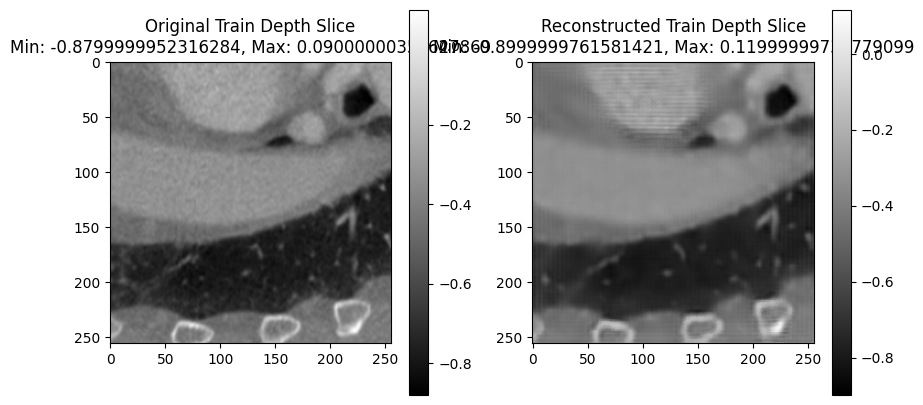

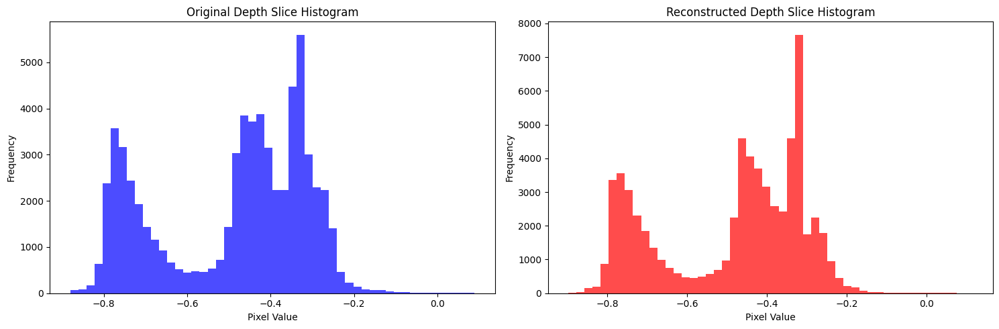

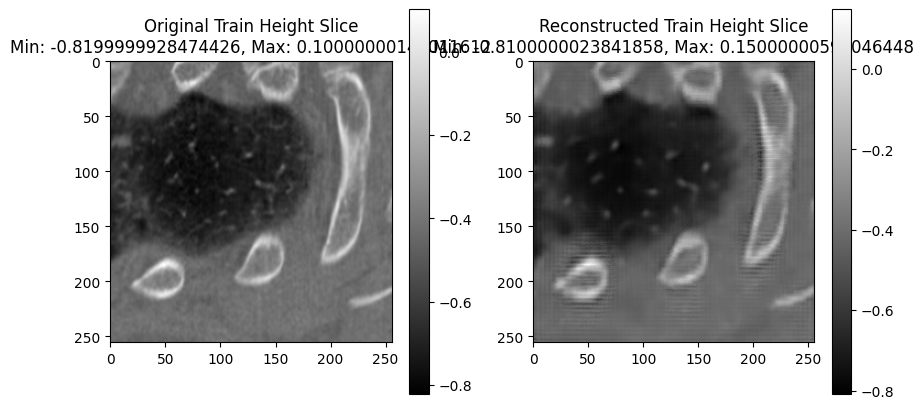

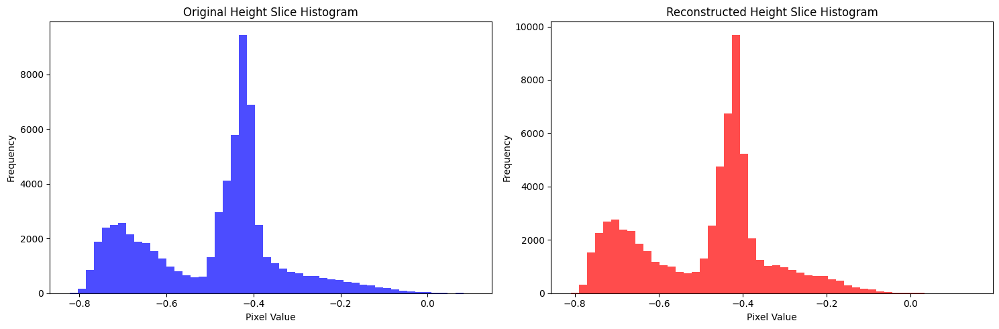

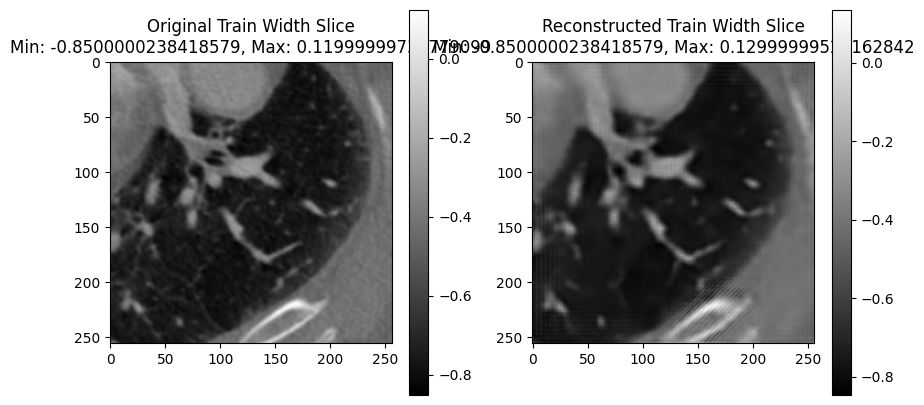

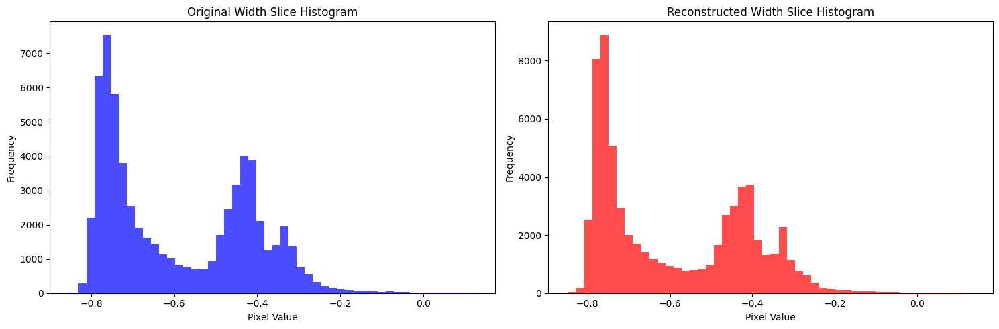

Validation: |          | 0/? [00:00<?, ?it/s]

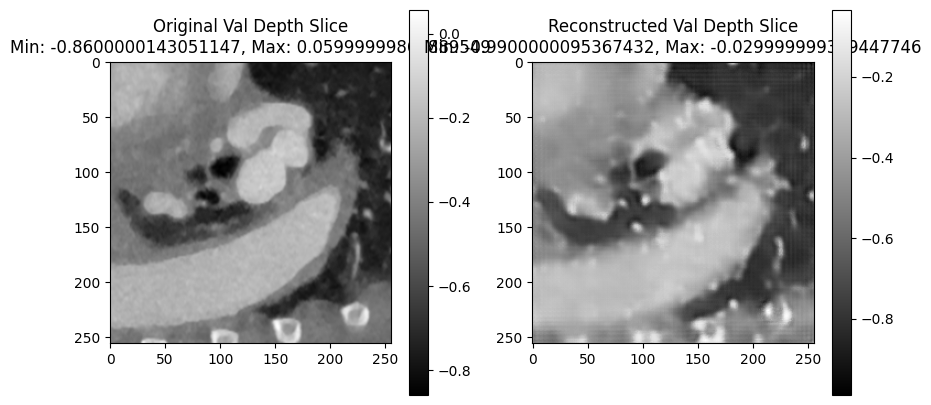

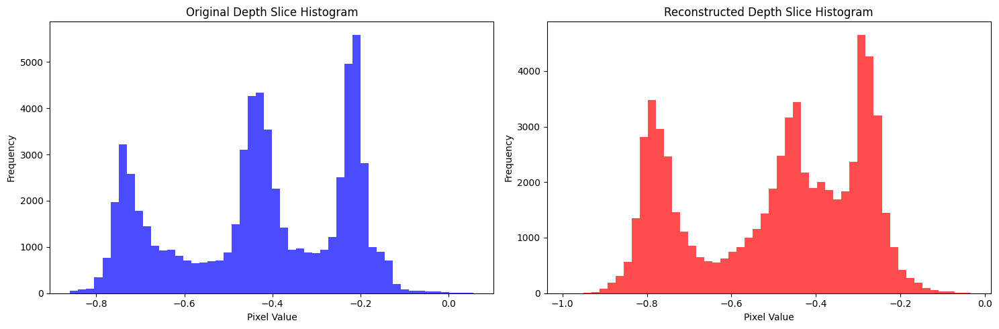

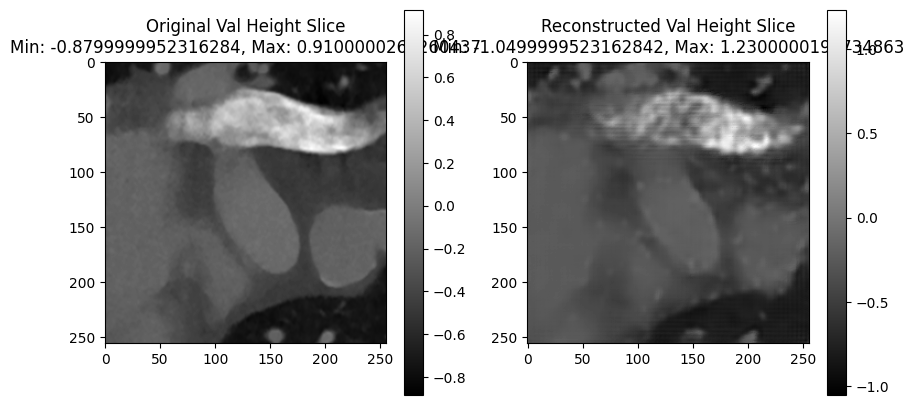

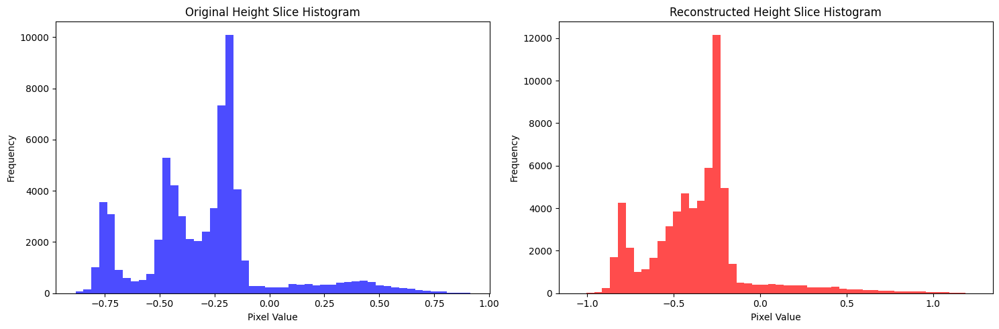

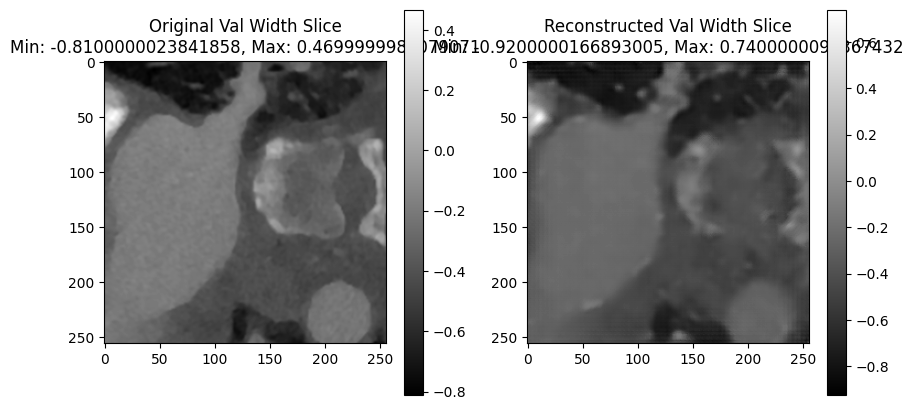

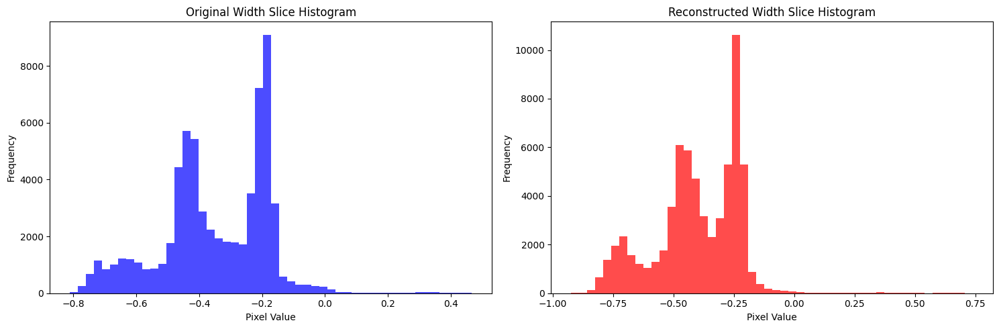

Time Spent 13868.23
Epoch: 1501


`Trainer.fit` stopped: `max_epochs=1501` reached.


FIT Profiler Report

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Action                                                                                                                                                           	|  Mean duration (s)	|  Num calls      	|  Total time (s) 	|  Percentage %   	|
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  Total                                                                                                                                                            	|  -              	|  1387057      

In [5]:
# Initialize model and start training
ExperimentDescription = 'I-AE Job10 64C Loss'
ShowInterval = 300
model = AutoEncoderModel()
trainer.fit(model, train_dataloader, val_dataloader)
# torch.save(model.state_dict(), folder_path + '/aeSSIM.pth')